# Pump it Up: Data Mining the Water Table

<img src="https://www.unicef.org/tanzania/sites/unicef.org.tanzania/files/styles/hero_extended/public/3Q3B7561.jpg.webp?itok=KaBYJOSo" width="600" />

# 1. Load packages

In [269]:
#  Suppress Warnings 
import warnings
warnings.filterwarnings('ignore')

# Core Data & Numerical Packages 
import pandas as pd             # DataFrame / series operations
import numpy as np              # Numerical computing

#  Date/Time, HTTP & Regex 
from datetime import datetime   # Date/time parsing and manipulation
import requests                 # HTTP requests (APIs, downloads)
import re                       # Regular expressions

#  Statistics & Hypothesis Testing 
import scipy.stats              # Descriptive & inferential stats
from scipy.stats import chi2_contingency  # Chi-square test

#  Visualization 
import matplotlib.pyplot as plt  # Static plotting
import seaborn as sns            # Statistical plotting
sns.set()                        # Seaborn style defaults
get_ipython().run_line_magic('matplotlib', 'inline')  # Inline Jupyter plots

import plotly.express as px      # Interactive plots
import plotly.graph_objects as go

#  Preprocessing & Encoding 
from sklearn.preprocessing import (
    LabelEncoder, OneHotEncoder,
    StandardScaler, MinMaxScaler
)
from category_encoders import TargetEncoder  # Mean-encoding for high-cardinality

#  Resampling 
from imblearn.over_sampling import SMOTE  # Synthetic minority oversampling

#  Model Selection & Validation 
from sklearn.model_selection import (
    train_test_split,
    cross_val_score,
    GridSearchCV,
    StratifiedKFold
)

#  Classical ML Models 
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    RandomForestClassifier,
    AdaBoostClassifier
)
from sklearn.svm import LinearSVC, SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.cluster import KMeans       # Unsupervised clustering

#  Gradient Boosting Frameworks 
from xgboost import XGBClassifier
import lightgbm as lgb

#  Evaluation Metrics 
from sklearn.metrics import (
    accuracy_score, f1_score,
    precision_score, recall_score,
    auc, roc_curve,
    confusion_matrix,
    classification_report
)

#  Utilities & Persistence 
from collections import defaultdict
from tqdm.auto import tqdm        # Progress bars
from fuzzywuzzy import fuzz, process  # String/fuzzy matching
import joblib                     # Model serialization
import pickle                     # General object serialization

#  Display & Pandas Settings 
pd.set_option('display.max_columns', 120)
pd.set_option('display.max_colwidth', 5000)
pd.set_option('display.max_rows', 100)


# 2. Load data

In [136]:
# Read data from local paths (adjust paths as needed)

training_set_values = pd.read_csv(r"C:\Users\andre\Desktop\Tarea Machine Learning\training_set_values.csv")
training_set_labels = pd.read_csv(r"C:\Users\andre\Desktop\Tarea Machine Learning\training_set_labels.csv")

In [137]:
print("shape of training_set_values:", training_set_values.shape)
print("shape of training_set_labels:", training_set_labels.shape)

shape of training_set_values: (59400, 40)
shape of training_set_labels: (59400, 2)


In [138]:
# Merge features and labels on 'id'
df = pd.merge(training_set_values, training_set_labels, on='id')

In [139]:
df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


In [140]:
# Get summary of dtypes and non-null counts
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55763 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59398 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

# 3 Missing values

Compute the percentage of missing values in each column to identify where imputation is needed.

In [141]:
# Percentage of missing values per column
(df.isna().sum()/ len(df) * 100).sort_values(ascending=False)

scheme_name              48.501684
scheme_management         6.528620
installer                 6.153199
funder                    6.122896
public_meeting            5.612795
permit                    5.144781
subvillage                0.624579
wpt_name                  0.003367
id                        0.000000
latitude                  0.000000
longitude                 0.000000
date_recorded             0.000000
gps_height                0.000000
amount_tsh                0.000000
num_private               0.000000
basin                     0.000000
region                    0.000000
ward                      0.000000
lga                       0.000000
district_code             0.000000
region_code               0.000000
recorded_by               0.000000
population                0.000000
construction_year         0.000000
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group    

In [142]:
# Display the top 20 most frequent values (as percentages) in the 'funder' column. This helps identify how dominant certain funders are in the dataset
(df['funder'].value_counts(normalize=True) * 100).head(20)

funder
Government Of Tanzania    16.290372
Danida                     5.584348
Hesawa                     3.948855
Rwssp                      2.463999
World Bank                 2.419167
Kkkt                       2.307982
World Vision               2.234457
Unicef                     1.895522
Tasaf                      1.572727
District Council           1.511755
Dhv                        1.486649
Private Individual         1.481269
Dwsp                       1.454369
0                          1.393397
Norad                      1.371877
Germany Republi            1.093915
Tcrs                       1.079569
Ministry Of Water          1.058049
Water                      1.045496
Dwe                        0.867959
Name: proportion, dtype: float64

In [143]:
# Similarly, analyze the top 20 'installer' values by percentage
(df['installer'].value_counts(normalize=True) * 100).head(20)

installer
DWE                   31.217150
Government             3.273836
RWE                    2.163423
Commu                  1.901516
DANIDA                 1.883577
KKKT                   1.610907
Hesawa                 1.506862
0                      1.393847
TCRS                   1.268275
Central government     1.115795
CES                    1.094269
Community              0.992017
DANID                  0.990223
District Council       0.988429
HESAWA                 0.966903
LGA                    0.731904
World vision           0.731904
WEDECO                 0.712171
TASAF                  0.710378
District council       0.703202
Name: proportion, dtype: float64

In [144]:
# Similarly, analyze the top 20 'scheme_management' values by percentage
(df['scheme_management'].value_counts(normalize=True) * 100).head(20)

scheme_management
VWC                 66.267426
WUG                  9.376463
Water authority      5.678830
WUA                  5.192536
Water Board          4.949389
Parastatal           3.025828
Private operator     1.914556
Company              1.910954
Other                1.379633
SWC                  0.174706
Trust                0.129678
Name: proportion, dtype: float64

In [145]:
# Similarly, analyze the top 20 'scheme_name' values by percentage
(df['scheme_name'].value_counts(normalize=True) * 100).head(20)

scheme_name
K                                        2.229487
Borehole                                 1.784897
Chalinze wate                            1.323962
M                                        1.307617
DANIDA                                   1.238967
Government                               1.046093
Ngana water supplied scheme              0.882641
wanging'ombe water supply s              0.853220
wanging'ombe supply scheme               0.764956
I                                        0.748611
Bagamoyo wate                            0.748611
Uroki-Bomang'ombe water sup              0.683230
N                                        0.666885
Kirua kahe gravity water supply trust    0.630925
Machumba estate pipe line                0.604773
Makwale water supplied sche              0.542661
Kijiji                                   0.526316
S                                        0.503432
Losaa-Kia water supply                   0.496894
Handeni Trunk Main(H                  

I decide to fill the null values as follows:

1. `funder`, `installer`, `scheme_management`, `permit`, and `public_meeting`: I will fill them with the mode
2. `scheme_name`, `subvillage`, and `wpt_name`: I will replace the `NaN` with a new label, `Unknown`

In [146]:
# Fill with mode for specified columns
for col in ['funder', 'installer', 'scheme_management', 'permit', 'public_meeting']:
    df[col].fillna(df[col].mode()[0], inplace=True)

# Fill with 'Unknown' for other categorical fields
    df.fillna({'scheme_name': 'Unknown', 'wpt_name': 'Unknown', 'subvillage': 'Unknown'}, inplace=True)

In [147]:
# Verify no remaining missing values
(df.isna().sum()/ len(df) * 100).sort_values(ascending=False).head(10)

id               0.0
amount_tsh       0.0
date_recorded    0.0
funder           0.0
gps_height       0.0
installer        0.0
longitude        0.0
latitude         0.0
wpt_name         0.0
num_private      0.0
dtype: float64

# 4. Numeric and Categorical variables

In [148]:
# Find all categorical variables
numeric_columns = df.select_dtypes(include=np.number).columns.tolist()
print("Numerical columns:", numeric_columns)

Numerical columns: ['id', 'amount_tsh', 'gps_height', 'longitude', 'latitude', 'num_private', 'region_code', 'district_code', 'population', 'construction_year']


In [149]:
# Find all object‐ or category‐dtype columns
cat_cols = df.select_dtypes(include=['object','category']).columns.tolist()
print("Categorical columns:", cat_cols)

Categorical columns: ['date_recorded', 'funder', 'installer', 'wpt_name', 'basin', 'subvillage', 'region', 'lga', 'ward', 'recorded_by', 'scheme_management', 'scheme_name', 'extraction_type', 'extraction_type_group', 'extraction_type_class', 'management', 'management_group', 'payment', 'payment_type', 'water_quality', 'quality_group', 'quantity', 'quantity_group', 'source', 'source_type', 'source_class', 'waterpoint_type', 'waterpoint_type_group', 'status_group']


# 5. Correlations - Numeric variables

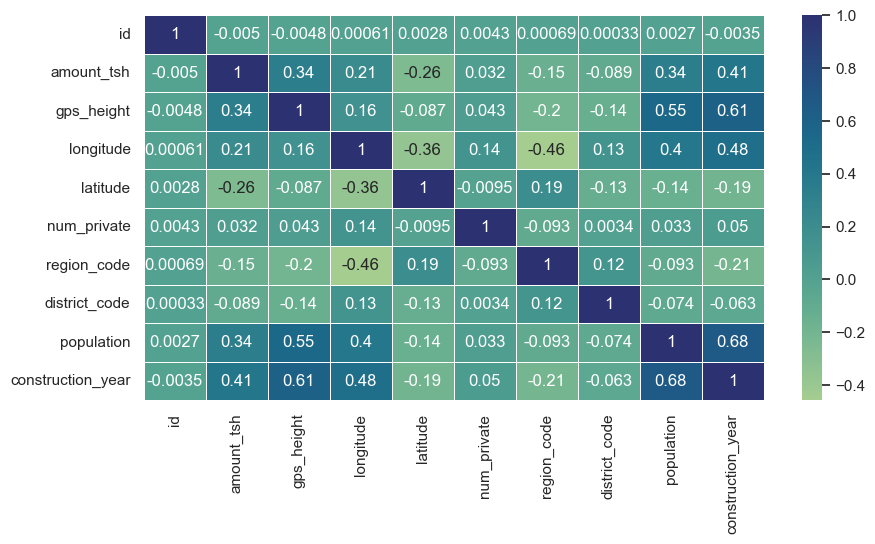

In [150]:
# Plotting the heatmap of the correlation values
cmap = 'crest'
plt.figure(figsize=(10,5), dpi=100)
sns.heatmap(df[numeric_columns].corr('spearman'),
            linewidths=.5,
            cmap=cmap,
            annot=True);

plt.show()

Population, elevation (GPS height) and construction year are all strongly positively correlated (ρ≈0.55–0.68), indicating that newer pumps tend to be built in higher-elevation, more populous areas.  Water yield (amount\_tsh) also shows a moderate positive link to both population and construction year (ρ≈0.34–0.41), whereas variables like region\_code, district\_code and num\_private have almost no monotonic relationship with the others.

# 6. Analysis of the `num_private` variable

In [151]:
# the following variable has no description in the delivery, now i analyze it
num_private_percent = (df['num_private'].value_counts(normalize=True) * 100).head(20)
print(num_private_percent)

num_private
0      98.725589
6       0.136364
1       0.122896
5       0.077441
8       0.077441
32      0.067340
45      0.060606
15      0.058923
39      0.050505
93      0.047138
3       0.045455
7       0.043771
2       0.038721
65      0.037037
47      0.035354
102     0.033670
4       0.033670
17      0.028620
80      0.025253
20      0.023569
Name: proportion, dtype: float64


In [152]:
df = df.drop("num_private", axis=1)

Due to the low variability of the `num_private` variable — with over 98% of the values being the same — I decided to drop it as it does not contribute meaningful information to the dataset.


# 7. Analysis of similar variables

In [153]:
def compare_categorical_columns(col1: pd.Series,
                                col2: pd.Series,
                                normalize: str = "columns",
                                cmap: str = "viridis",
                                figsize: tuple = (10, 8)
                               ) -> dict:
    """
    Compare two categorical Series:
      - Print unique values in each
      - Print categories unique to each
      - Print row-wise match counts
      - Display a heatmap of the crosstab (%)
      - Print & return the chi-square p-value
    
    Returns a dict with:
      'unique_1', 'unique_2', 'only_in_1', 'only_in_2',
      'matches_counts', 'crosstab', 'chi2_pvalue'
    """
    #  Raw uniques
    print(f"Unique values in {col1.name}: {col1.unique()}")
    print(f"Unique values in {col2.name}: {col2.unique()}\n")
    
    #  Unique sets difference
    only_in_1 = set(col1.unique()) - set(col2.unique())
    only_in_2 = set(col2.unique()) - set(col1.unique())
    print(f"In {col1.name} but not in {col2.name}: {only_in_1}")
    print(f"In {col2.name} but not in {col1.name}: {only_in_2}")
    
    #  Row-wise equality
    matches = col1 == col2
    print("\nRows exactly matching:")
    print(matches.value_counts(normalize=True))
    
    #  Crosstab + heatmap
    print(f"\nCrosstab of {col1.name} vs {col2.name}:")
    crosstab = pd.crosstab(col1, col2, normalize=normalize) * 100
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(crosstab, cmap=cmap, annot=True, fmt=".1f", ax=ax)
    plt.ylabel(col1.name)
    plt.xlabel(col2.name)
    plt.title("Crosstab (% of columns)")
    plt.show()
    
    #  Chi-square test
    chi2, p, dof, expected = chi2_contingency(pd.crosstab(col1, col2))
    print(f"\nChi-square test p-value: {p:.4f}")
    
    return {
        "unique_1": col1.unique(),
        "unique_2": col2.unique(),
        "only_in_1": only_in_1,
        "only_in_2": only_in_2,
        "matches_counts": matches.value_counts(dropna=False),
        "crosstab": crosstab,
        "chi2_pvalue": p
    }


I created the function above  to use it with variables that looks similars.

## a. Payment vs. Payment Type

Unique values in payment: ['pay annually' 'never pay' 'pay per bucket' 'unknown'
 'pay when scheme fails' 'other' 'pay monthly']
Unique values in payment_type: ['annually' 'never pay' 'per bucket' 'unknown' 'on failure' 'other'
 'monthly']

In payment but not in payment_type: {'pay monthly', 'pay per bucket', 'pay annually', 'pay when scheme fails'}
In payment_type but not in payment: {'monthly', 'per bucket', 'annually', 'on failure'}

Rows exactly matching:
True     0.581801
False    0.418199
Name: proportion, dtype: float64

Crosstab of payment vs payment_type:


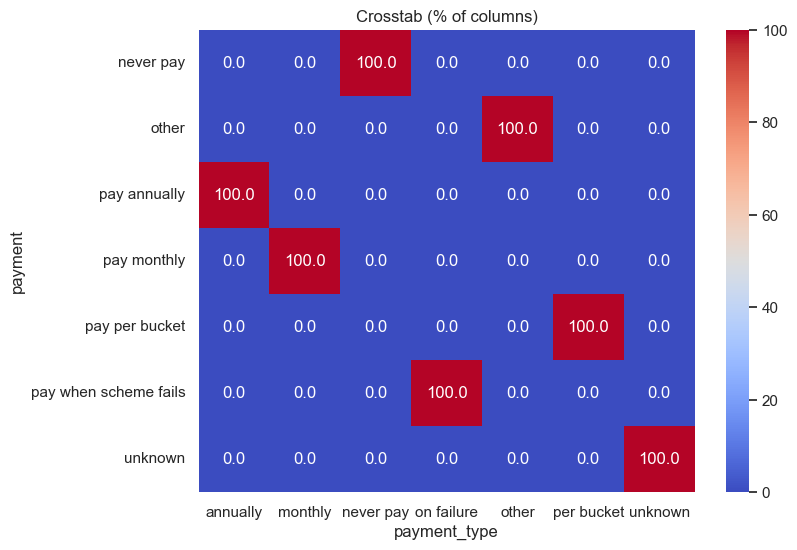


Chi-square test p-value: 0.0000


In [154]:
results = compare_categorical_columns(
    df['payment'],
    df['payment_type'],
    normalize= "columns",   
    cmap="coolwarm",       
    figsize=(8,6)
)


The $p$ - value is zero, we can thus reject the null hypothesis and conclude that `payment` and `payment_type` are not independent.

Both columns contain the same information, so there is no need to keep both, we keep the variable a little bit precise, with 7 values.

In [155]:
df = df.drop('payment_type', axis=1)

## b. Quantity vs. Quantity Group

In [156]:
print(df['quantity'].unique())
print(df['quantity_group'].unique())

['enough' 'insufficient' 'dry' 'seasonal' 'unknown']
['enough' 'insufficient' 'dry' 'seasonal' 'unknown']


In [157]:
(df['quantity'] == df['quantity_group']).value_counts()

True    59400
Name: count, dtype: int64

In [158]:
# The columns are exactly the same, so we remove one
df = df.drop('quantity_group', axis=1)

## c. Waterpoint type vs Waterpoint type group

Unique values in waterpoint_type: ['communal standpipe' 'communal standpipe multiple' 'hand pump' 'other'
 'improved spring' 'cattle trough' 'dam']
Unique values in waterpoint_type_group: ['communal standpipe' 'hand pump' 'other' 'improved spring'
 'cattle trough' 'dam']

In waterpoint_type but not in waterpoint_type_group: {'communal standpipe multiple'}
In waterpoint_type_group but not in waterpoint_type: set()

Rows exactly matching:
True     0.897256
False    0.102744
Name: proportion, dtype: float64

Crosstab of waterpoint_type vs waterpoint_type_group:


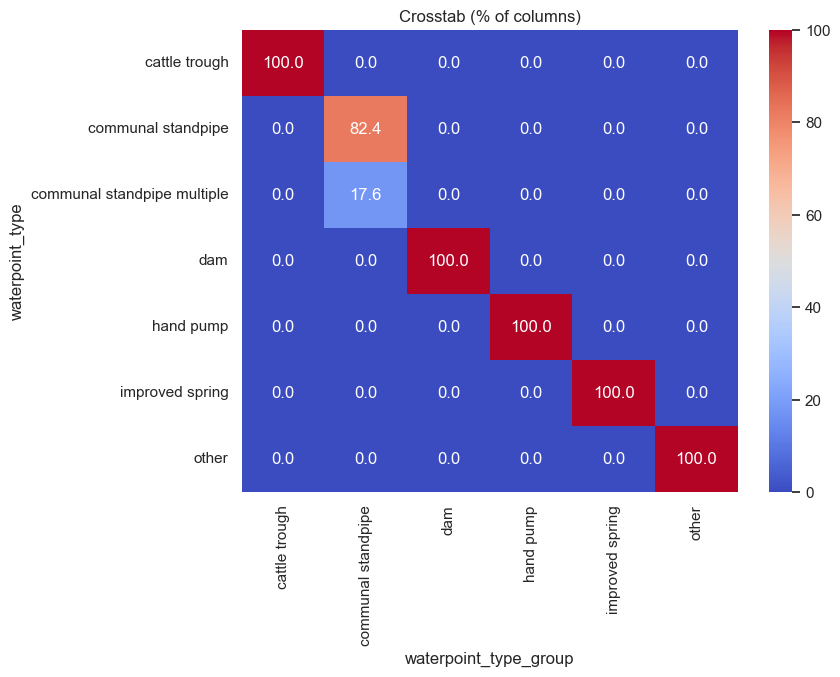


Chi-square test p-value: 0.0000


In [159]:
results = compare_categorical_columns(
    df['waterpoint_type'],
    df['waterpoint_type_group'],
    normalize="columns",   
    cmap="coolwarm",       
    figsize=(8,6)
)

The $p$ - value is zero, we can thus reject the null hypothesis and conclude that `payment` and `payment_type` are not independent.
Both columns contain the same information, so there is no need to keep both

In [160]:
# We will eliminate the column that contains 6 different values
df = df.drop("waterpoint_type_group", axis=1)

## d. Extraction's variables

In this analysis, we use Cramér’s V to measure the strength of association between categorical variables. Unlike Pearson correlation (used for numerical data), Cramér’s V is designed to quantify the relationship between two categorical columns. Its value ranges from 0 (no association) to 1 (perfect association).

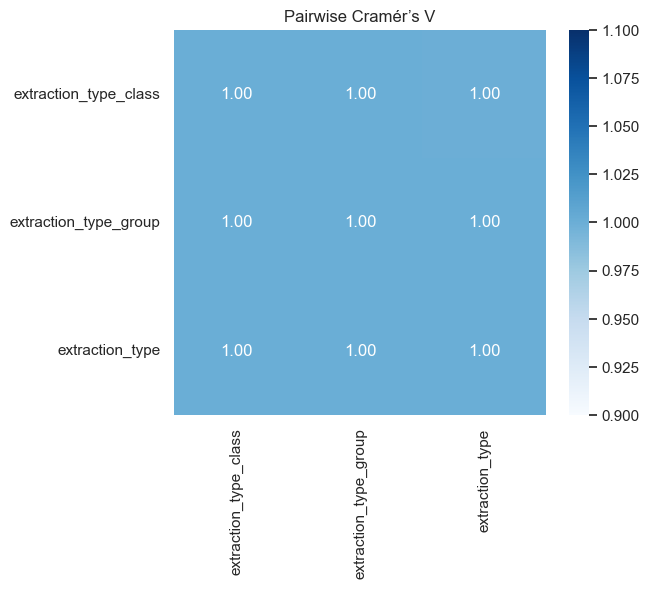

In [161]:
# define a function for Cramér’s V
def cramers_v(x, y):
    """Return Cramér’s V statistic for two categorical Series."""
    cm = pd.crosstab(x, y)
    chi2 = chi2_contingency(cm)[0]
    n = cm.sum().sum()
    phi2 = chi2 / n
    r, k = cm.shape
    return np.sqrt(phi2 / (min(r-1, k-1)))

# pick  three columns
cats = ['extraction_type_class', 'extraction_type_group', 'extraction_type']

# build the pairwise matrix
cramers = pd.DataFrame(index=cats, columns=cats, dtype=float)
for i in cats:
    for j in cats:
        cramers.loc[i, j] = cramers_v(df[i], df[j])

# visualize as a heatmap
plt.figure(figsize=(6,5))
sns.heatmap(cramers, annot=True, fmt=".2f", cmap="Blues")
plt.title("Pairwise Cramér’s V")
plt.show()

The matrix we obtain shows values of 1 for every pair of variables, including cross comparisons

This means:

The three variables are perfectly associated with one another. 
Each value in one column always maps to a specific value in the others.
These columns are redundant.

In practice, you can keep just one of them (preferably the simplest or most descriptive), as using all three does not provide any additional information.

In [162]:
print(df['extraction_type'].nunique())
print("")
print(df['extraction_type_group'].nunique())
print("")
print(df['extraction_type_class'].nunique())

18

13

7


In addition to the previous analysis, let's go and see and study the various variables coupled together

### extraction_type vs. extraction_type_group

Unique values in extraction_type: ['gravity' 'submersible' 'swn 80' 'nira/tanira' 'india mark ii' 'other'
 'ksb' 'mono' 'windmill' 'afridev' 'other - rope pump' 'india mark iii'
 'other - swn 81' 'other - play pump' 'cemo' 'climax' 'walimi'
 'other - mkulima/shinyanga']
Unique values in extraction_type_group: ['gravity' 'submersible' 'swn 80' 'nira/tanira' 'india mark ii' 'other'
 'mono' 'wind-powered' 'afridev' 'rope pump' 'india mark iii'
 'other handpump' 'other motorpump']

In extraction_type but not in extraction_type_group: {'other - rope pump', 'climax', 'windmill', 'other - play pump', 'ksb', 'other - swn 81', 'cemo', 'walimi', 'other - mkulima/shinyanga'}
In extraction_type_group but not in extraction_type: {'other motorpump', 'wind-powered', 'other handpump', 'rope pump'}

Rows exactly matching:
True     0.958434
False    0.041566
Name: proportion, dtype: float64

Crosstab of extraction_type vs extraction_type_group:


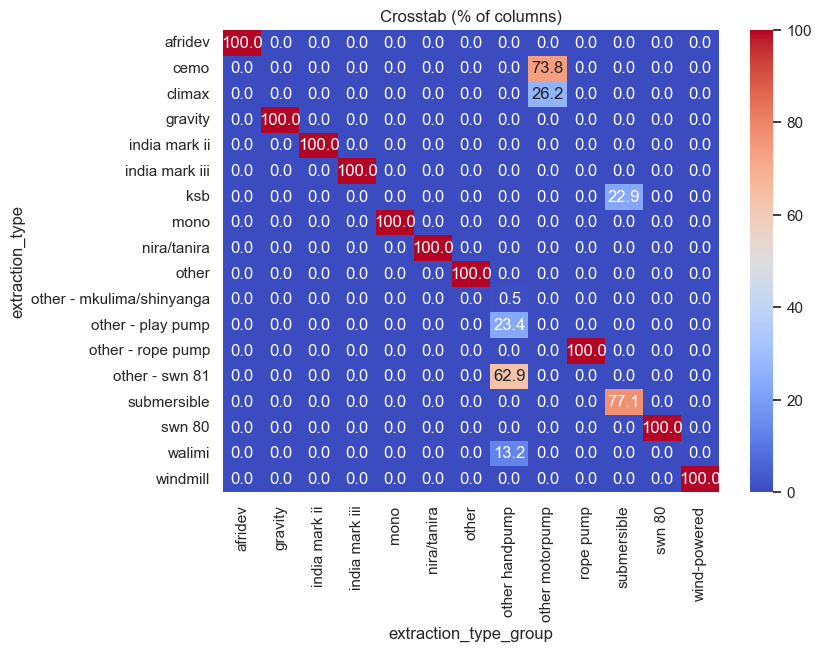


Chi-square test p-value: 0.0000


In [163]:
results = compare_categorical_columns(
    df['extraction_type'].str.lower().str.strip(), # Normalize both columns (lowercase + strip)
    df['extraction_type_group'].str.lower().str.strip(),
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(8,6)
)

Now let's build a dictionary (group_to_types) that maps each extraction type group (extraction_type_group) to a list of extraction types (extraction_type). We will do the same thing with the other analysis pairs

In [164]:
# build a map: group → list of types
group_to_types = (
    df[['extraction_type','extraction_type_group']]
      .drop_duplicates()
      .groupby('extraction_type_group')['extraction_type']
      .apply(list)
      .to_dict()
)

for grp, types in group_to_types.items():
    print(f"\n{grp.upper()}:")
    for t in types:
        print("  -", t)


AFRIDEV:
  - afridev

GRAVITY:
  - gravity

INDIA MARK II:
  - india mark ii

INDIA MARK III:
  - india mark iii

MONO:
  - mono

NIRA/TANIRA:
  - nira/tanira

OTHER:
  - other

OTHER HANDPUMP:
  - other - swn 81
  - other - play pump
  - walimi
  - other - mkulima/shinyanga

OTHER MOTORPUMP:
  - cemo
  - climax

ROPE PUMP:
  - other - rope pump

SUBMERSIBLE:
  - submersible
  - ksb

SWN 80:
  - swn 80

WIND-POWERED:
  - windmill


### extraction_type_class vs. extraction_type_group
 

Unique values in extraction_type_class: ['gravity' 'submersible' 'handpump' 'other' 'motorpump' 'wind-powered'
 'rope pump']
Unique values in extraction_type_group: ['gravity' 'submersible' 'swn 80' 'nira/tanira' 'india mark ii' 'other'
 'mono' 'wind-powered' 'afridev' 'rope pump' 'india mark iii'
 'other handpump' 'other motorpump']

In extraction_type_class but not in extraction_type_group: {'handpump', 'motorpump'}
In extraction_type_group but not in extraction_type_class: {'other motorpump', 'india mark ii', 'swn 80', 'india mark iii', 'mono', 'other handpump', 'afridev', 'nira/tanira'}

Rows exactly matching:
True     0.672677
False    0.327323
Name: proportion, dtype: float64

Crosstab of extraction_type_class vs extraction_type_group:


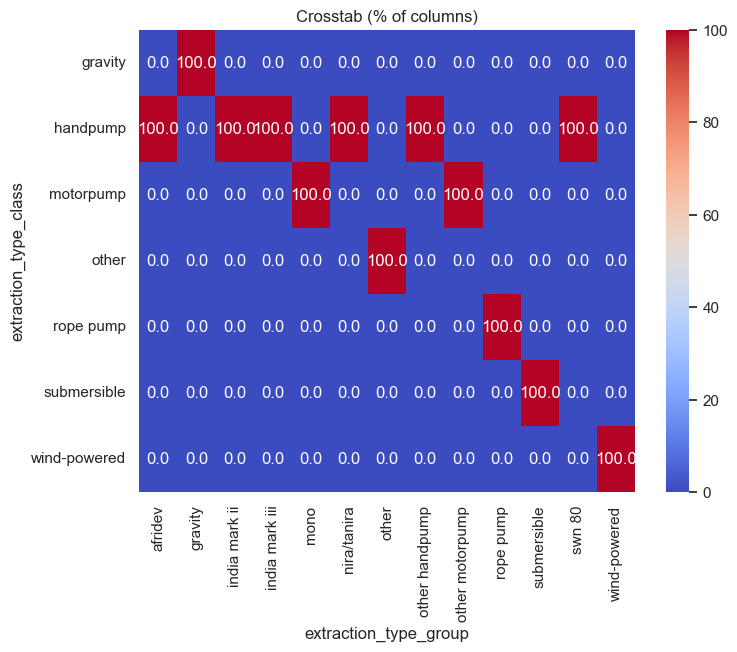


Chi-square test p-value: 0.0000


In [165]:
results = compare_categorical_columns(
    df['extraction_type_class'].str.lower().str.strip(), # Normalize both columns (lowercase + strip)
    df['extraction_type_group'].str.lower().str.strip(),
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(8,6)
)

In [166]:
group_to_types = (
    df[['extraction_type_class','extraction_type_group']]
      .drop_duplicates()
      .groupby('extraction_type_group')['extraction_type_class']
      .apply(list)
      .to_dict()
)

for grp, types in group_to_types.items():
    print(f"\n{grp.upper()}:")
    for t in types:
        print("  -", t)


AFRIDEV:
  - handpump

GRAVITY:
  - gravity

INDIA MARK II:
  - handpump

INDIA MARK III:
  - handpump

MONO:
  - motorpump

NIRA/TANIRA:
  - handpump

OTHER:
  - other

OTHER HANDPUMP:
  - handpump

OTHER MOTORPUMP:
  - motorpump

ROPE PUMP:
  - rope pump

SUBMERSIBLE:
  - submersible

SWN 80:
  - handpump

WIND-POWERED:
  - wind-powered


### extraction_type_class vs. extraction_type

Unique values in extraction_type_class: ['gravity' 'submersible' 'handpump' 'other' 'motorpump' 'wind-powered'
 'rope pump']
Unique values in extraction_type: ['gravity' 'submersible' 'swn 80' 'nira/tanira' 'india mark ii' 'other'
 'ksb' 'mono' 'windmill' 'afridev' 'other - rope pump' 'india mark iii'
 'other - swn 81' 'other - play pump' 'cemo' 'climax' 'walimi'
 'other - mkulima/shinyanga']

In extraction_type_class but not in extraction_type: {'handpump', 'wind-powered', 'motorpump', 'rope pump'}
In extraction_type but not in extraction_type_class: {'other - rope pump', 'climax', 'windmill', 'other - play pump', 'ksb', 'india mark ii', 'other - swn 81', 'swn 80', 'india mark iii', 'mono', 'cemo', 'walimi', 'afridev', 'other - mkulima/shinyanga', 'nira/tanira'}

Rows exactly matching:
True     0.639293
False    0.360707
Name: proportion, dtype: float64

Crosstab of extraction_type_class vs extraction_type:


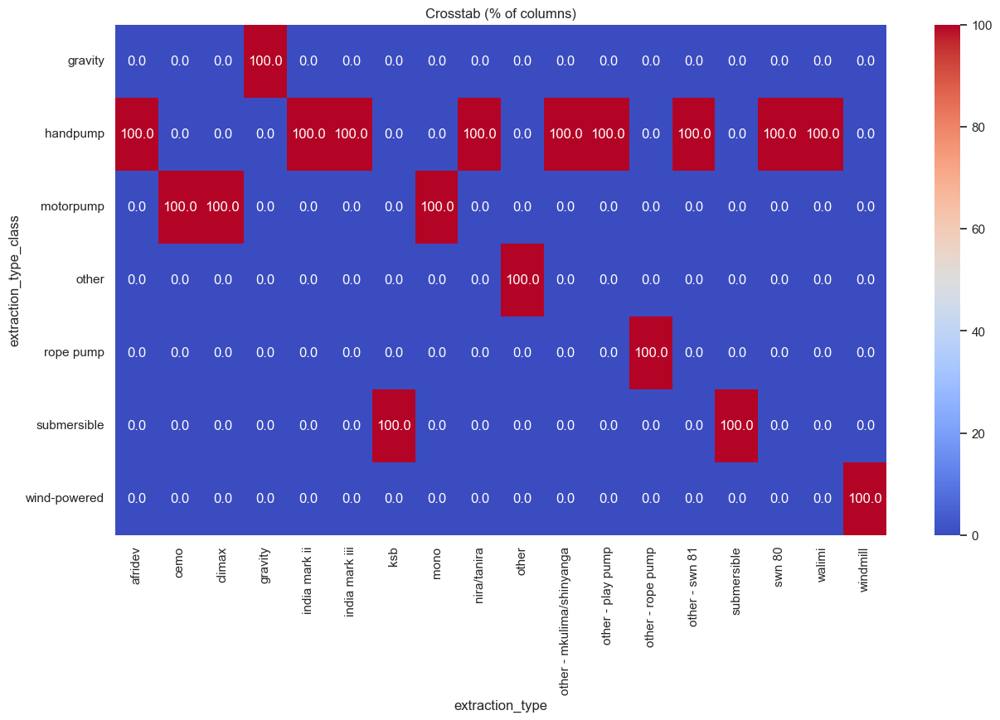


Chi-square test p-value: 0.0000


In [167]:
results = compare_categorical_columns(
    df['extraction_type_class'].str.lower().str.strip(), # Normalize both columns (lowercase + strip)
    df['extraction_type'].str.lower().str.strip(),
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

In [168]:
group_to_types = (
    df[['extraction_type','extraction_type_class']]
      .drop_duplicates()
      .groupby('extraction_type_class')['extraction_type']
      .apply(list)
      .to_dict()
)

for grp, types in group_to_types.items():
    print(f"\n{grp.upper()}:")
    for t in types:
        print("  -", t)


GRAVITY:
  - gravity

HANDPUMP:
  - swn 80
  - nira/tanira
  - india mark ii
  - afridev
  - india mark iii
  - other - swn 81
  - other - play pump
  - walimi
  - other - mkulima/shinyanga

MOTORPUMP:
  - mono
  - cemo
  - climax

OTHER:
  - other

ROPE PUMP:
  - other - rope pump

SUBMERSIBLE:
  - submersible
  - ksb

WIND-POWERED:
  - windmill


After analyzing all three variables, we found that they essentially provide the same information, just in different formats. Therefore, we decided to keep only `extraction_type_class` and drop the other two because even if it has fewer "values", it is the most precise and tidy, avoiding redundant values

In [169]:
df = df.drop(["extraction_type", "extraction_type_group"], axis=1)

## e. Source's variables 

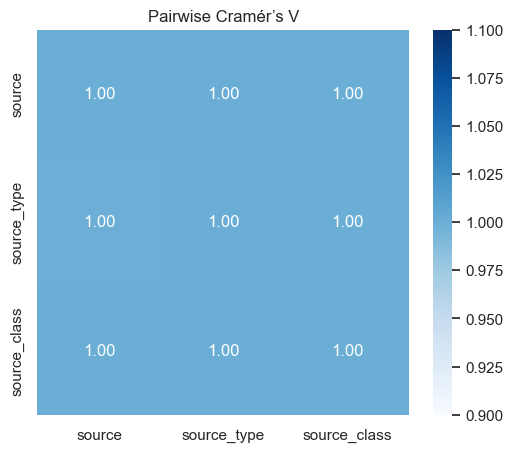

In [170]:
# define a function for Cramér’s V
def cramers_v(x, y):
    """Return Cramér’s V statistic for two categorical Series."""
    cm = pd.crosstab(x, y)
    chi2 = chi2_contingency(cm)[0]
    n = cm.sum().sum()
    phi2 = chi2 / n
    r, k = cm.shape
    return np.sqrt(phi2 / (min(r-1, k-1)))

# pick three columns
cats = ['source', 'source_type', 'source_class']

# build the pairwise matrix
cramers = pd.DataFrame(index=cats, columns=cats, dtype=float)
for i in cats:
    for j in cats:
        cramers.loc[i, j] = cramers_v(df[i], df[j])

# visualize as a heatmap
plt.figure(figsize=(6,5))
sns.heatmap(cramers, annot=True, fmt=".2f", cmap="Blues")
plt.title("Pairwise Cramér’s V")
plt.show()

The matrix we obtain shows values of 1 for every pair of variables, including cross comparisons

This means:

The three variables are perfectly associated with one another. Each value in one column always maps to a specific value in the others. These columns are redundant.

In practice, you can keep just one of them (preferably the simplest or most descriptive), as using all three does not provide any additional information.

### source vs source_type

Unique values in source: ['spring' 'rainwater harvesting' 'dam' 'machine dbh' 'other'
 'shallow well' 'river' 'hand dtw' 'lake' 'unknown']
Unique values in source_type: ['spring' 'rainwater harvesting' 'dam' 'borehole' 'other' 'shallow well'
 'river/lake']

In source but not in source_type: {'lake', 'river', 'unknown', 'hand dtw', 'machine dbh'}
In source_type but not in source: {'river/lake', 'borehole'}

Rows exactly matching:
True     0.62303
False    0.37697
Name: proportion, dtype: float64

Crosstab of source vs source_type:


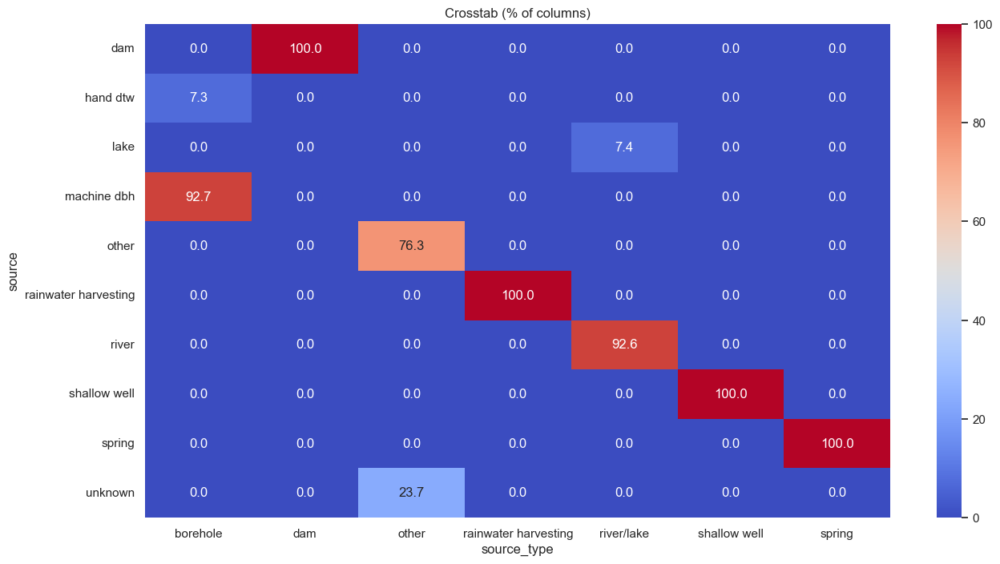


Chi-square test p-value: 0.0000


In [171]:
results = compare_categorical_columns(
    df['source'],
    df['source_type'],
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

### source_class vs source_type

Unique values in source_class: ['groundwater' 'surface' 'unknown']
Unique values in source_type: ['spring' 'rainwater harvesting' 'dam' 'borehole' 'other' 'shallow well'
 'river/lake']

In source_class but not in source_type: {'groundwater', 'surface', 'unknown'}
In source_type but not in source_class: {'river/lake', 'spring', 'other', 'dam', 'shallow well', 'rainwater harvesting', 'borehole'}

Rows exactly matching:
False    1.0
Name: proportion, dtype: float64

Crosstab of source_class vs source_type:


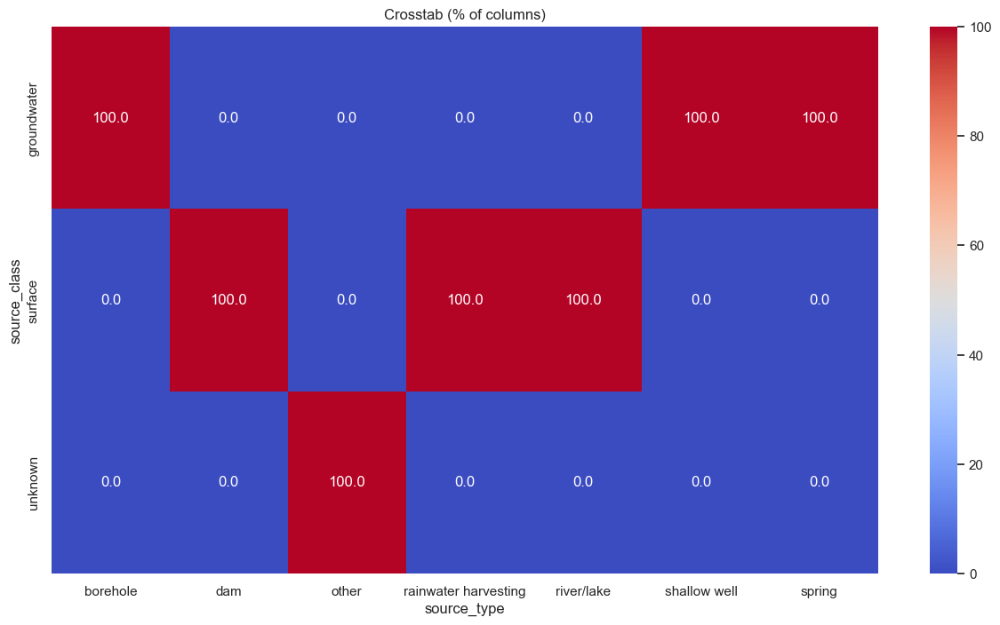


Chi-square test p-value: 0.0000


In [172]:
results = compare_categorical_columns(
    df['source_class'],
    df['source_type'],
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

### source_class vs source

Unique values in source_class: ['groundwater' 'surface' 'unknown']
Unique values in source: ['spring' 'rainwater harvesting' 'dam' 'machine dbh' 'other'
 'shallow well' 'river' 'hand dtw' 'lake' 'unknown']

In source_class but not in source: {'groundwater', 'surface'}
In source but not in source_class: {'spring', 'other', 'dam', 'lake', 'river', 'shallow well', 'rainwater harvesting', 'hand dtw', 'machine dbh'}

Rows exactly matching:
False    0.998889
True     0.001111
Name: proportion, dtype: float64

Crosstab of source_class vs source:


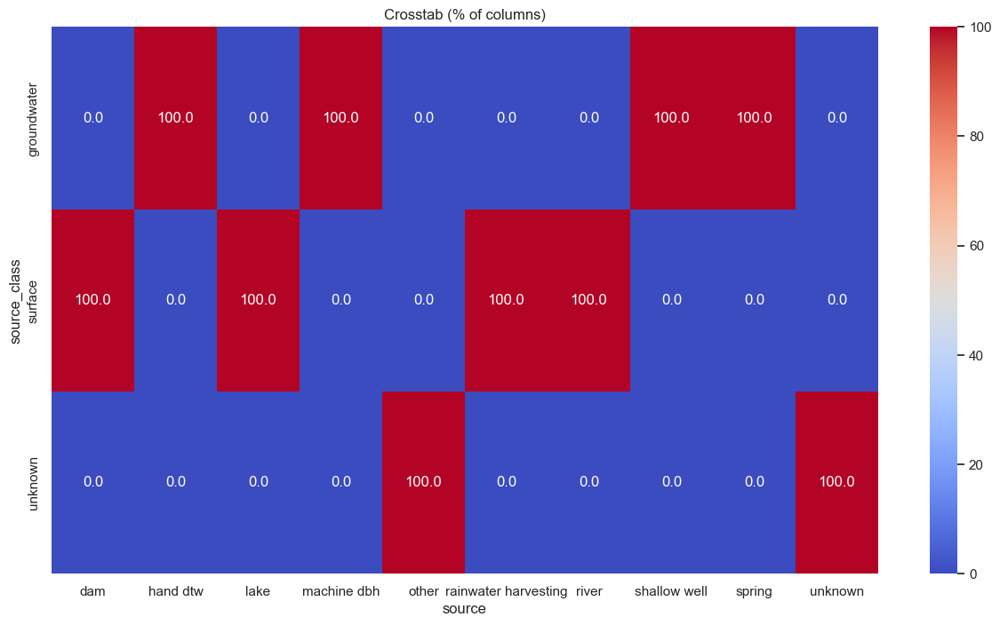


Chi-square test p-value: 0.0000


In [173]:
results = compare_categorical_columns(
    df['source_class'],
    df['source'],
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

After analyzing all three variables, we found that they essentially provide the same information, just in different formats. Therefore, we decided to keep only "source_type" and drop the other two."


In [174]:
df = df.drop(["source", "source_class"], axis =1)

## f. Water Quality vs. Quality group

Unique values in water_quality: ['soft' 'salty' 'milky' 'unknown' 'fluoride' 'coloured' 'salty abandoned'
 'fluoride abandoned']
Unique values in quality_group: ['good' 'salty' 'milky' 'unknown' 'fluoride' 'colored']

In water_quality but not in quality_group: {'fluoride abandoned', 'coloured', 'salty abandoned', 'soft'}
In quality_group but not in water_quality: {'good', 'colored'}

Rows exactly matching:
False    0.869764
True     0.130236
Name: proportion, dtype: float64

Crosstab of water_quality vs quality_group:


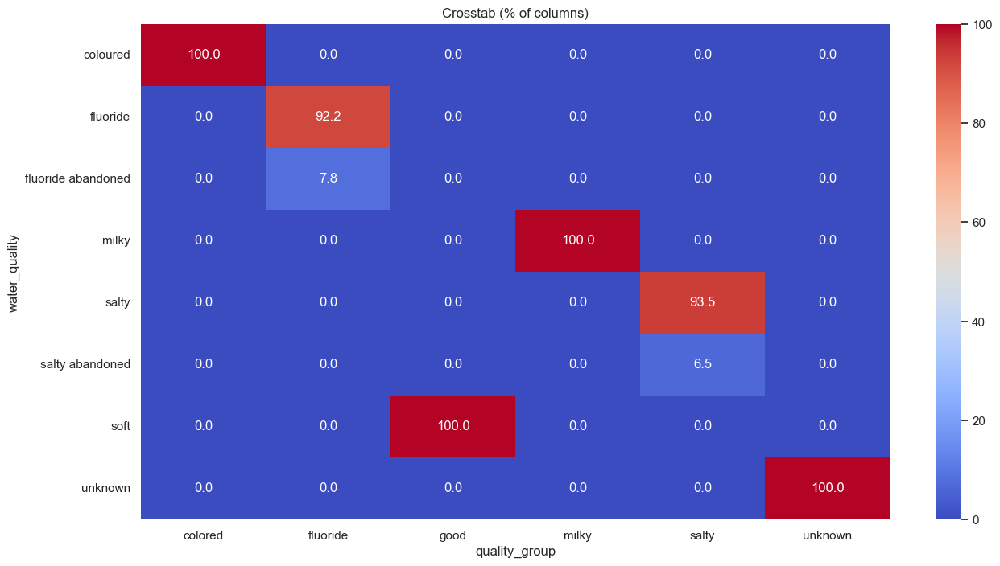


Chi-square test p-value: 0.0000


In [175]:
result = compare_categorical_columns(
    df['water_quality'],
    df['quality_group'],
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

In [176]:
# We decide to keep the column "quality_group" because is more precise and do not has similars valuses and we rename the column to "water_quality_group"
df = df.drop("water_quality", axis=1)
df = df.rename(columns={'quality_group': 'water_quality_group'})

In [177]:
df.shape

(59400, 32)

## g. Recorded By

In [178]:
print(df['recorded_by'].unique())

['GeoData Consultants Ltd']


In [179]:
# I delete recorded_by because it has only one value
df = df.drop('recorded_by', axis=1)

## h. Region vs Region Code

In [180]:
# Look at all unique region names
df['region'].unique()

array(['Iringa', 'Mara', 'Manyara', 'Mtwara', 'Kagera', 'Tanga',
       'Shinyanga', 'Tabora', 'Pwani', 'Ruvuma', 'Kilimanjaro', 'Rukwa',
       'Mwanza', 'Kigoma', 'Lindi', 'Dodoma', 'Arusha', 'Mbeya',
       'Singida', 'Morogoro', 'Dar es Salaam'], dtype=object)

In [181]:
# Look at all unique region_code names

df['region_code'].unique()

array([11, 20, 21, 90, 18,  4, 17, 14, 60, 10,  3, 15, 19, 16, 80,  1,  6,
        2, 12, 13,  5,  7, 99, 24,  9,  8, 40])

In [182]:
# Test the association between region and region_code using chi-squared test
col1 = df['region']
col2 = df['region_code']
print(chi2_contingency(pd.crosstab(col1, col2))[1])

0.0


In [183]:
# Does each region map to exactly one region_code?
region_to_codes = df.groupby('region')['region_code'].nunique()
print("Every region has a single code? →", (region_to_codes == 1).all())

# Does each region_code map to exactly one region?
code_to_regions = df.groupby('region_code')['region'].nunique()
print("Every code has a single region? →", (code_to_regions == 1).all())

Every region has a single code? → False
Every code has a single region? → False


In [184]:
#  How many distinct codes each region has
region_to_codes = df.groupby('region')['region_code'].nunique()

# list the “bad” regions that map to >1 code
bad_regions = region_to_codes[region_to_codes > 1]
print("Regions with multiple codes:\n", bad_regions, "\n")

# for each one, show exactly which codes appear
for region in bad_regions.index:
    codes = df.loc[df['region'] == region, 'region_code'].unique()
    print(f"{region!r} → codes {codes}")


Regions with multiple codes:
 region
Arusha       2
Lindi        3
Mtwara       3
Mwanza       2
Pwani        3
Shinyanga    3
Tanga        2
Name: region_code, dtype: int64 

'Arusha' → codes [ 2 24]
'Lindi' → codes [80 18  8]
'Mtwara' → codes [90 99  9]
'Mwanza' → codes [19 17]
'Pwani' → codes [60  6 40]
'Shinyanga' → codes [17 14 11]
'Tanga' → codes [4 5]


In [185]:
code_to_regions = df.groupby('region_code')['region'].nunique()
bad_codes = code_to_regions[code_to_regions > 1]
print("\nCodes with multiple region names:\n", bad_codes, "\n")

for code in bad_codes.index:
    names = df.loc[df['region_code'] == code, 'region'].unique()
    print(f"{code} → regions {names}")



Codes with multiple region names:
 region_code
5     2
11    2
14    2
17    2
18    2
Name: region, dtype: int64 

5 → regions ['Morogoro' 'Tanga']
11 → regions ['Iringa' 'Shinyanga']
14 → regions ['Tabora' 'Shinyanga']
17 → regions ['Shinyanga' 'Mwanza']
18 → regions ['Kagera' 'Lindi']


I decided to keep the 'region' variable instead of 'region_code', because when using the machine learning model, the numeric values of region_code might mislead the model by giving undue importance to numbers that are actually just labels. It's therefore more accurate and straightforward to convert a string like region into a suitable numeric representation, such as through encoding.

In [186]:

df = df.drop("region_code", axis =1)

## i. Region vs. District code

In [187]:
df['district_code'].unique()

array([ 5,  2,  4, 63,  1,  8,  3,  6, 43,  7, 23, 33, 53, 62, 60, 30, 13,
        0, 80, 67])

Unique values in region: ['Iringa' 'Mara' 'Manyara' 'Mtwara' 'Kagera' 'Tanga' 'Shinyanga' 'Tabora'
 'Pwani' 'Ruvuma' 'Kilimanjaro' 'Rukwa' 'Mwanza' 'Kigoma' 'Lindi' 'Dodoma'
 'Arusha' 'Mbeya' 'Singida' 'Morogoro' 'Dar es Salaam']
Unique values in district_code: [ 5  2  4 63  1  8  3  6 43  7 23 33 53 62 60 30 13  0 80 67]

In region but not in district_code: {'Arusha', 'Tabora', 'Singida', 'Kilimanjaro', 'Iringa', 'Kigoma', 'Mwanza', 'Manyara', 'Dar es Salaam', 'Morogoro', 'Mbeya', 'Mtwara', 'Rukwa', 'Pwani', 'Ruvuma', 'Mara', 'Tanga', 'Kagera', 'Lindi', 'Dodoma', 'Shinyanga'}
In district_code but not in region: {np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(13), np.int64(23), np.int64(30), np.int64(33), np.int64(43), np.int64(53), np.int64(60), np.int64(62), np.int64(63), np.int64(67), np.int64(80)}

Rows exactly matching:
False    1.0
Name: proportion, dtype: float64

Crosstab of region vs district_code:


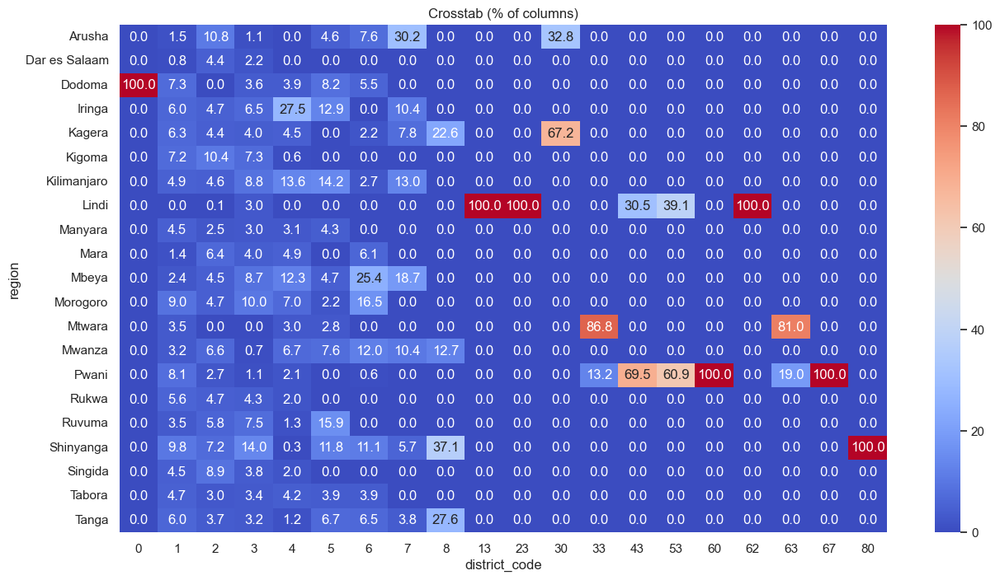


Chi-square test p-value: 0.0000


In [188]:
result = compare_categorical_columns(
    df['region'],
    df['district_code'],
    normalize="columns",  
    cmap="coolwarm",      
    figsize=(15,8)
)

I decided to keep the 'region' variable instead of 'district_code', because when using the machine learning model, the numeric values of district_code might mislead the model by giving undue importance to numbers that are actually just labels. It's therefore more accurate and straightforward to convert a string like region into a suitable numeric representation, such as through encoding.

In [189]:
df = df.drop("district_code", axis=1)

# 8. Duplicates

In [190]:
# How many duplicate rows in the entire DataFrame?
n_dupes = df.duplicated().sum()
print(f"Found {n_dupes} duplicate rows out of {len(df)} total rows.")

# View the first few duplicate rows
dupe_rows = df[df.duplicated()]
print(dupe_rows.head())

Found 0 duplicate rows out of 59400 total rows.
Empty DataFrame
Columns: [id, amount_tsh, date_recorded, funder, gps_height, installer, longitude, latitude, wpt_name, basin, subvillage, region, lga, ward, population, public_meeting, scheme_management, scheme_name, permit, construction_year, extraction_type_class, management, management_group, payment, water_quality_group, quantity, source_type, waterpoint_type, status_group]
Index: []


Even though the dataset had no duplicate rows, I still performed the check as part of standard data preprocessing. Ensuring there are no duplicates helps maintain data quality and prevents potential bias during model training.

# 9. Possible errors

 Let's see when we have values equal to zero to detect possible errors

In [191]:
# Calculate percentage of zeros in each column, sort descending

zero_sorted = ((df == 0).sum() / len(df) * 100).sort_values(ascending=False)
print(zero_sorted)

amount_tsh               70.099327
population               35.994949
construction_year        34.863636
gps_height               34.407407
permit                   29.447811
public_meeting            8.510101
longitude                 3.050505
id                        0.001684
wpt_name                  0.000000
funder                    0.000000
installer                 0.000000
latitude                  0.000000
date_recorded             0.000000
lga                       0.000000
region                    0.000000
subvillage                0.000000
basin                     0.000000
scheme_management         0.000000
ward                      0.000000
scheme_name               0.000000
extraction_type_class     0.000000
management                0.000000
management_group          0.000000
payment                   0.000000
water_quality_group       0.000000
quantity                  0.000000
source_type               0.000000
waterpoint_type           0.000000
status_group        

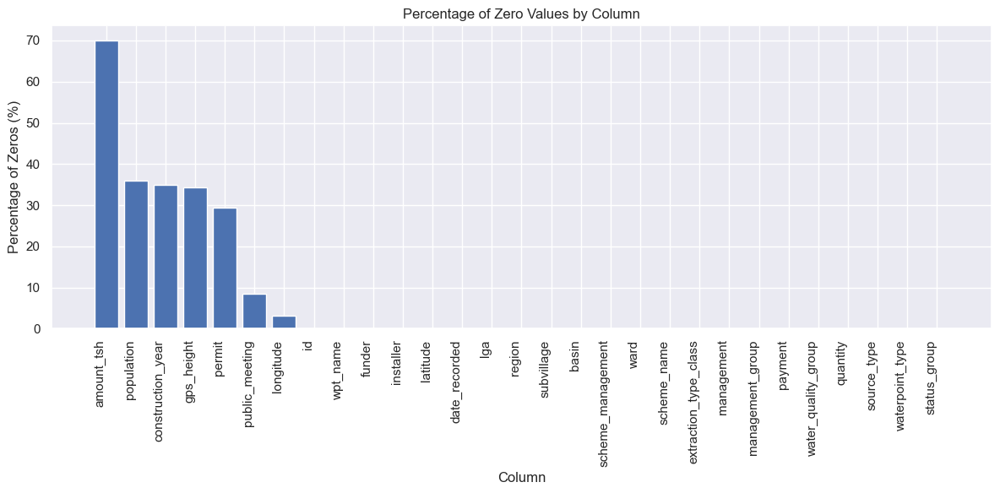

In [192]:
# Visualize the percentage of zero values across columns

# compute percentage of zeros
zero_percent = (df == 0).sum() / len(df) * 100
zero_sorted  = zero_percent.sort_values(ascending=False)

#  plot
plt.figure(figsize=(12, 6))
plt.bar(zero_sorted.index, zero_sorted.values)
plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Zeros (%)')
plt.xlabel('Column')
plt.title('Percentage of Zero Values by Column')
plt.tight_layout()
plt.show()

## a. Permit & Public Meeting

In [193]:
df.permit.value_counts()

permit
True     41908
False    17492
Name: count, dtype: int64

In [194]:
df.public_meeting.value_counts()

public_meeting
True     54345
False     5055
Name: count, dtype: int64

Here, we verify that these binary fields do not treat 0 as a missing value — 0 represents False. We decide not to modify these.

## b. Longitude


In [195]:
# This line of code calculates the mode of the 'longitude' column in df, excluding any values that are equal to 0.

moda_long = df.loc[df['longitude'] != 0, 'longitude'].mode().iloc[0]
print(moda_long)

31.61952953


In [196]:
# This replaces all values equal to 0 in the 'longitude' column with the value stored in moda_long.

df['longitude'] = df['longitude'].replace(0, moda_long)

In [197]:
df['longitude'].isnull().value_counts()

longitude
False    59400
Name: count, dtype: int64

## c. Population

In [198]:
print(df['population'].describe())

count    59400.000000
mean       179.909983
std        471.482176
min          0.000000
25%          0.000000
50%         25.000000
75%        215.000000
max      30500.000000
Name: population, dtype: float64


In [199]:
fig = px.box(df, x='population', 
             title='Population Distribution',
             labels={'population':'Population'})

fig.show()

### Outliers of population

We will replace zero populations with trimmed mean (excluding outliers), then we will remove remaining outliers above IQR threshold because...

In [200]:
#  grab the series
pop = df['population']

#  define your non‐zero, non‐outlier mask
mask = pop.gt(0)  # only positive values
q1, q3 = pop[mask].quantile([0.25, 0.75])
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr

good = mask & pop.le(upper_bound)  # >0 AND <= upper_bound

# compute the mean on that trimmed set
mean_trimmed = pop[good].mean()

# replace zeros with that mean
df['population'] = pop.replace(0, mean_trimmed)

#  check
print(f"Using mean={mean_trimmed:.2f} to fill zeros")
print(df['population'].describe())

Using mean=182.19 to fill zeros
count    59400.000000
mean       245.487513
std        454.253148
min          1.000000
25%        100.000000
50%        182.185365
75%        215.000000
max      30500.000000
Name: population, dtype: float64


In [201]:
upper_bound

750.0

In [202]:
df = df[df['population'] <= upper_bound]

In [203]:
fig = px.box(df, x='population', 
             title='Population Distribution',
             labels={'population':'Population'})

fig.show()

In [204]:
df.population.describe()

count    56927.000000
mean       182.185365
std        140.853523
min          1.000000
25%         89.000000
50%        182.185365
75%        200.000000
max        750.000000
Name: population, dtype: float64

## d. Year of construction

In [205]:
print(df['construction_year'].describe())

count    56927.000000
mean      1272.838073
std        959.982587
min          0.000000
25%          0.000000
50%       1985.000000
75%       2004.000000
max       2013.000000
Name: construction_year, dtype: float64


In [206]:
# Finds the most frequent (mode) construction year, excluding values equal to 0, and replaces all 0 values in the 'construction_year' column with that mode:

mode_year = df.loc[df['construction_year'] != 0, 'construction_year'].mode()[0]
df.loc[df['construction_year'] == 0, 'construction_year'] = mode_year
print(f"The mode is: {mode_year}")

The mode is: 2010


In [207]:
print(df['construction_year'].describe())

count    56927.000000
mean      2001.567674
std         11.852678
min       1960.000000
25%       1996.000000
50%       2008.000000
75%       2010.000000
max       2013.000000
Name: construction_year, dtype: float64


## e. amount_tsh 

In [208]:
zero_pct_amount_tsh = (df['amount_tsh'] == 0).sum() / len(df) * 100
print(zero_pct_amount_tsh)

70.76079891791241


In [209]:
# I delete amount_tsh because it has 70% zeros
df = df.drop('amount_tsh', axis=1)

## f. Gps height

In [210]:
# Show the number of null of the variable gps_height
df.gps_height[df.gps_height==0].count()

np.int64(20321)

In [211]:
print(df['gps_height'].describe())

count    56927.000000
mean       658.983259
std        695.113387
min        -90.000000
25%          0.000000
50%        351.000000
75%       1317.000000
max       2770.000000
Name: gps_height, dtype: float64


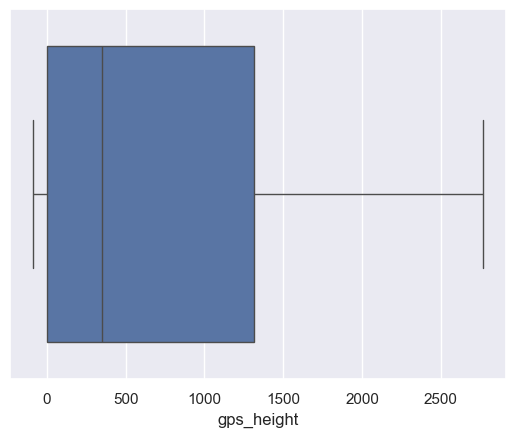

In [212]:
sns.boxplot(x=df['gps_height'])
plt.show()

In [213]:
# Compute the median of gps_height by region ignoring non‑positive values
regional_med = (
    df.loc[df['gps_height'] > 0]               # only positive altitudes
      .groupby('region')['gps_height']
      .median()
)

overall_med = df.loc[df['gps_height'] > 0, 'gps_height'].median()


# Build a mask of the “bad” rows
mask_bad = df['gps_height'] <= 0

# Impute: map each bad row’s region → its median, fall back to overall
df.loc[mask_bad, 'gps_height'] = (
    df.loc[mask_bad, 'region']
      .map(regional_med)                   # get region median
      .fillna(overall_med)                 # if region not in regional_med
)

In [214]:
regional_med

region
Arusha           1404.5
Dar es Salaam      48.0
Iringa           1720.0
Kigoma           1278.0
Kilimanjaro      1243.0
Lindi             262.0
Manyara          1473.0
Mara             1288.0
Morogoro          337.0
Mtwara            313.0
Mwanza           1186.0
Pwani              97.5
Rukwa            1452.0
Ruvuma            918.0
Shinyanga        1351.5
Singida          1489.0
Tanga             414.5
Name: gps_height, dtype: float64

In [215]:
# check
df.gps_height[df.gps_height==0].count()

np.int64(0)

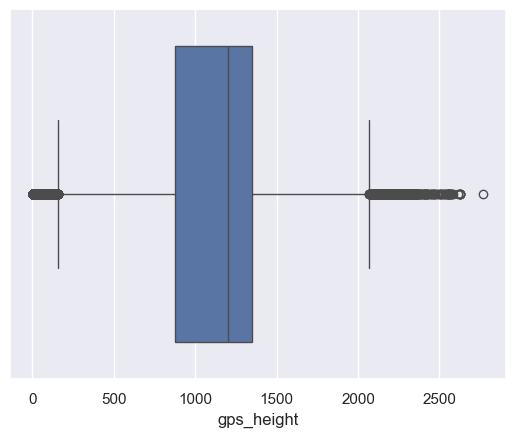

In [216]:
sns.boxplot(x=df['gps_height'])
plt.show()

In [217]:
print(df['gps_height'].describe())

count    56927.000000
mean      1094.699185
std        500.014494
min          1.000000
25%        873.000000
50%       1199.000000
75%       1351.500000
max       2770.000000
Name: gps_height, dtype: float64


# 10. Analysis of Cardinality

In [218]:
# compute nunique for every object column
nunique_series = df.select_dtypes(include='object').nunique()

# turn it into a DataFrame
nunique_df = nunique_series.rename_axis('column') \
                          .reset_index(name='nunique')

# sort descending
nunique_df = nunique_df.sort_values('nunique', ascending=False) \
                       .reset_index(drop=True)

nunique_df

,column,nunique
0,wpt_name,36096
1,subvillage,18663
2,scheme_name,2621
3,ward,2073
4,installer,2030
5,funder,1789
6,date_recorded,355
7,lga,125
8,region,21
9,management,12


We will analize the variables that have a hight number of unique values (the first 7 rows in the previous table)

## a. Scheme name

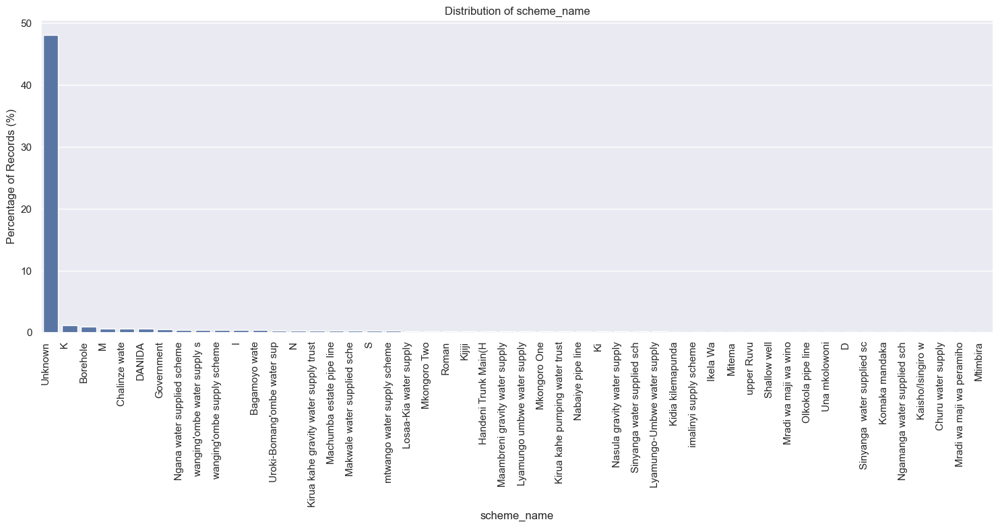

In [219]:
# compute percentages
counts = (df['scheme_name'].value_counts(normalize=True) * 100).head(50)

# make the plot
plt.figure(figsize=(15,8))
sns.barplot(x=counts.index, y=counts.values)

# polish
plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Records (%)')
plt.xlabel('scheme_name')
plt.title('Distribution of scheme_name')
plt.tight_layout()

plt.show()

## b. WPT name

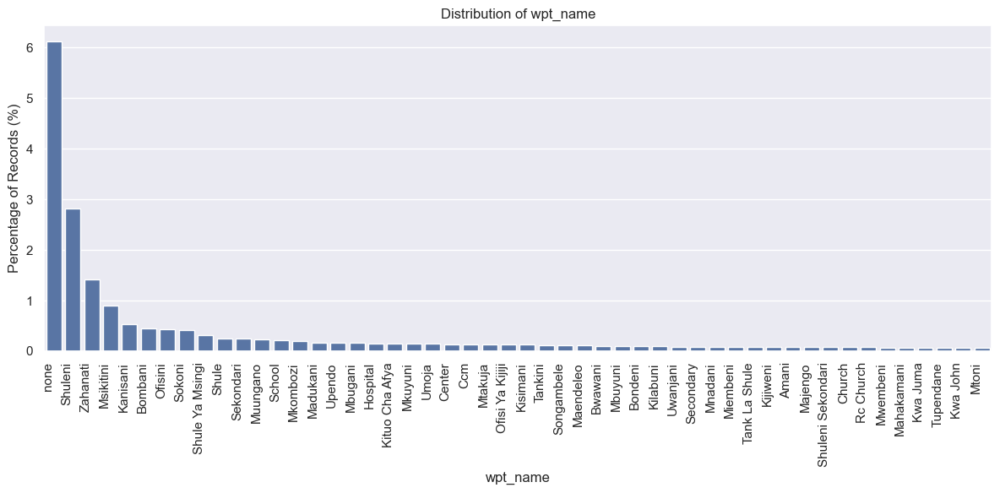

In [220]:
# compute percentages
counts = (df['wpt_name'].value_counts(normalize=True) * 100).head(50)

# make the plot
plt.figure(figsize=(12,6))
sns.barplot(x=counts.index, y=counts.values)

# polish
plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Records (%)')
plt.xlabel('wpt_name')
plt.title('Distribution of wpt_name')
plt.tight_layout()

plt.show()

We are removing the variables `scheme_name` and `wpt_name` due to their high cardinality. Specifically, `scheme_name` has the value `Unknown` in nearly 50% of the records, while `wpt_name` is dominated by the value `none`, making both variables uninformative.

In [221]:
df = df.drop(['scheme_name', 'wpt_name'], axis=1)

## c. Funder

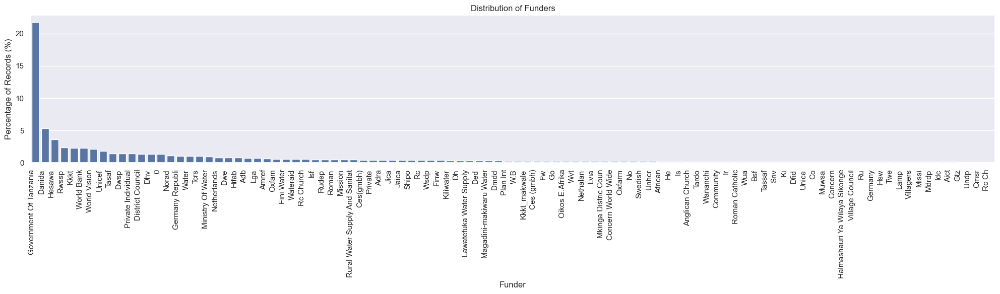

In [222]:
counts = (df['funder'].value_counts(normalize=True) * 100).head(100)

plt.figure(figsize=(20,6))
sns.barplot(x=counts.index, y=counts.values)

plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Records (%)')
plt.xlabel('Funder')
plt.title('Distribution of Funders')
plt.tight_layout()

plt.show()

In [223]:
print(df['funder'].describe())

count                      56927
unique                      1789
top       Government Of Tanzania
freq                       12387
Name: funder, dtype: object


In [224]:
sorted(df['funder'].unique())

['0',
 'A/co Germany',
 'Aar',
 'Abas Ka',
 'Abasia',
 'Abc-ihushi Development Cent',
 'Abd',
 'Abdala',
 'Abddwe',
 'Abdul',
 'Abood',
 'Abs',
 'Aco/germany',
 'Acord',
 'Acord Ngo',
 'Acra',
 'Act',
 'Act Mara',
 'Action Aid',
 'Action Contre La Faim',
 'Action In A',
 'Adap',
 'Adb',
 'Adf',
 'Adp',
 'Adp Bungu',
 'Adp Mombo',
 'Adp/w',
 'Adra',
 'Af',
 'Afdp',
 'Afric',
 'Africa',
 'Africa 2000 Network/undp',
 'Africa Amini Alama',
 'Africa Project Ev Germany',
 'African',
 'African 2000 Network',
 'African Barrick Gold',
 'African Development Bank',
 'African Development Foundation',
 'African Muslim Agency',
 'African Realief Committe Of Ku',
 'African Relie',
 'Africaone Ltd',
 'Africare',
 'Afriican Reli',
 'Afya Department Lindi Rural',
 'Agape Churc',
 'Agt Church',
 'Ahmadia',
 'Ai',
 'Aic',
 'Aic Church',
 'Aic Kij',
 'Aict',
 'Aimgold',
 'Aixos',
 'Alia',
 'Ambwene Mwaikek',
 'Amref',
 'Amrefe',
 'Anglican Church',
 'Angrikana',
 'Anjuman E Seifee',
 'Answeer Muslim Grou',

The consolidate_categories function helps me to clean up and simplify text categories in the DataFrame column, especially when there are duplicates, inconsistent names, or too many small groups.
It makes messy categorical data easier to work with, both for analysis and for training machine learning models.

In [225]:
def consolidate_categories(
    df: pd.DataFrame,
    column: str,
    similarity_cutoff: int = 75,
    major_pct: float = 2.0
) -> pd.DataFrame:
    """
    Clean, fuzzy-merge, and reduce low-frequency categories in df[column].
    
    Parameters
    ----------
    df : pd.DataFrame
        Input DataFrame.
    column : str
        Name of the column to process.
    similarity_cutoff : int, default=75
        Minimum fuzzywuzzy token_sort_ratio score (0–100) to consider a match.
    major_pct : float, default=2.0
        Categories accounting for less than this percentage will be labeled 'Other'.
    
    Returns
    -------
    pd.DataFrame
        The original df with three extra columns:
          {column}_clean, {column}_merged, {column}_reduced,
        and prints the final value-counts of the reduced column.
    """
    # 1. Normalize
    clean_col = f"{column}_clean"
    df[clean_col] = df[column].astype(str).str.lower().str.strip()
    
    # 2. Build mapping via fuzzy matching
    unique_names = df[clean_col].unique().tolist()
    freqs = df[clean_col].value_counts()
    mapping = {}
    
    for name in tqdm(unique_names, desc="Building fuzzy groups"):
        if name in mapping:
            continue
        matches = process.extract(name, unique_names, scorer=fuzz.token_sort_ratio)
        group = [m for m, score in matches if score >= similarity_cutoff]
        # pick the most frequent member as canonical
        canonical = freqs.loc[group].idxmax()
        for member in group:
            mapping[member] = canonical
    
    # 3. Apply mapping
    merged_col = f"{column}_merged"
    df[merged_col] = df[clean_col].map(mapping)
    
    # 4. Reduce small categories to "Other"
    pct = df[merged_col].value_counts(normalize=True) * 100
    major = pct[pct >= major_pct].index
    reduced_col = f"{column}_reduced"
    df[reduced_col] = df[merged_col].where(
        df[merged_col].isin(major),
        other="Other"
    )
    
    # 5. Report
    print(df[reduced_col].value_counts(normalize=True).mul(100).round(2))
    
    return df


In [226]:
df = consolidate_categories(df, column="funder", similarity_cutoff=90, major_pct=1)

Building fuzzy groups: 100%|██████████| 1789/1789 [01:25<00:00, 20.87it/s]

funder_reduced
Other                     45.57
government of tanzania    21.76
danida                     5.35
hesawa                     3.64
rwssp                      2.42
kkkt                       2.26
world bank                 2.25
world vision               2.16
unicef                     1.82
tasaf                      1.66
dwsp                       1.42
private individual         1.41
district council           1.38
dhv                        1.35
0                          1.32
norad                      1.14
germany republi            1.05
water                      1.02
tcrs                       1.02
Name: proportion, dtype: float64


In [227]:
df[["funder",'funder_merged', "funder_reduced"]].sample(50)

,funder,funder_merged,funder_reduced
25519,Water Aid /sema,water aid /sema,Other
45485,Unicef,unicef,unicef
13004,Government Of Tanzania,government of tanzania,government of tanzania
32295,Government Of Tanzania,government of tanzania,government of tanzania
27746,Bened,bened,Other
964,Kkkt,kkkt,kkkt
39044,Shipo,shipo,Other
4694,Un,un,Other
50031,Dhv,dhv,dhv
52656,Rwssp,rwssp,rwssp


 above you can watch an example of the function

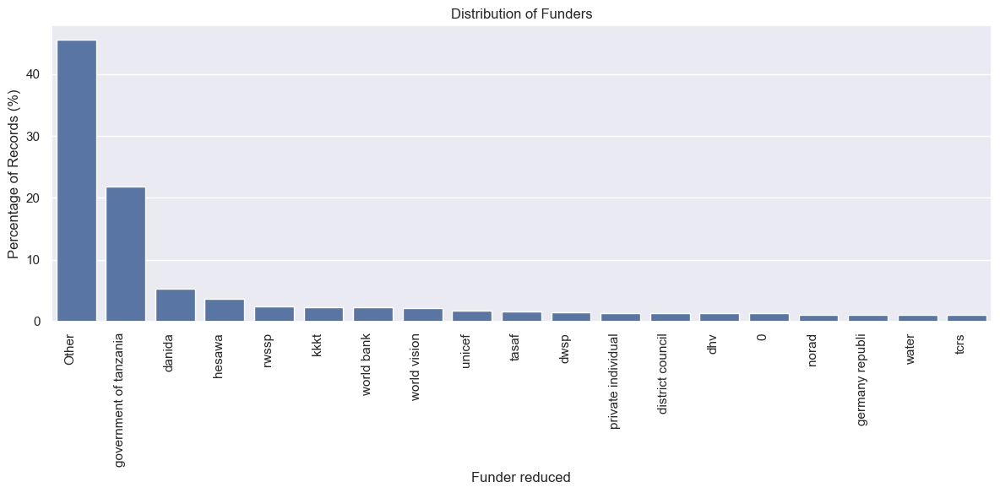

In [228]:
counts = (df['funder_reduced'].value_counts(normalize=True) * 100)


plt.figure(figsize=(12,6))
sns.barplot(x=counts.index, y=counts.values)

plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Records (%)')
plt.xlabel('Funder reduced')
plt.title('Distribution of Funders')
plt.tight_layout()
plt.show()

## d. Installer

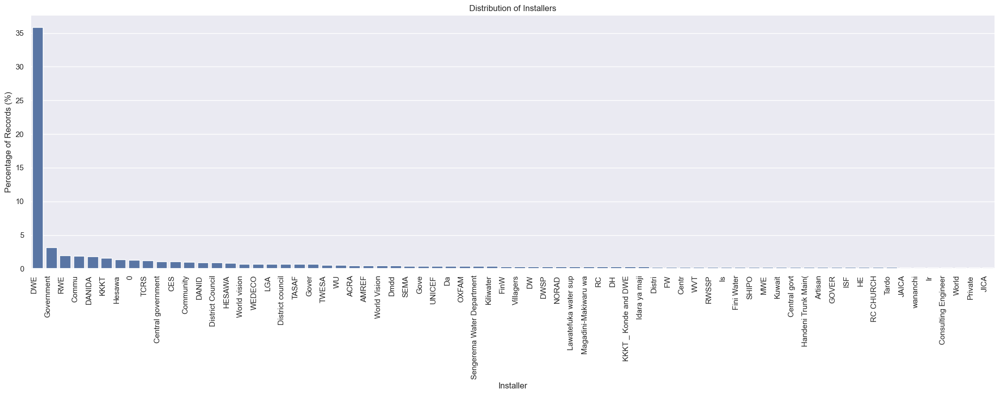

In [229]:
counts = (df['installer'].value_counts(normalize=True) * 100).head(70)


plt.figure(figsize=(20,8))
sns.barplot(x=counts.index, y=counts.values)


plt.xticks(rotation=90, ha='right')
plt.ylabel('Percentage of Records (%)')
plt.xlabel('Installer')
plt.title('Distribution of Installers')
plt.tight_layout()

plt.show()

In [230]:
sorted(df['installer'].dropna().unique())

['-',
 '0',
 'A.D.B',
 'AAR',
 'ABASIA',
 'ABD',
 'ABDALA',
 'ABDUL',
 'AC',
 'ACORD',
 'ACRA',
 'ACT',
 'ACT MARA',
 'ACTION AID',
 'ACTIVE TANK CO',
 'ACTIVE TANK CO LTD',
 'AD',
 'ADAP',
 'ADB',
 'ADP',
 'ADP Busangi',
 'ADRA',
 'ADRA /Government',
 'ADRA/Government',
 'AF',
 'AFRICA',
 'AFRICA MUSLIM',
 'AFRICAN DEVELOPMENT FOUNDATION',
 'AGRICAN',
 'AI',
 'AIC',
 'AIC KI',
 'AICT',
 'AIMGOLD',
 'AIXOS',
 'ALIA',
 'ALLYS',
 'AMP Contract',
 'AMP Contracts',
 'AMP contractor',
 'AMREF',
 'ANGLI',
 'ANGLIKANA CHURCH',
 'ANGRIKANA',
 'ANSWAR',
 'APM',
 'AQAL',
 'AQUA BLUES ANGELS',
 'AQUA WEL',
 'AQUA Wat',
 'AQUARMAN DRILLERS',
 'ASDP',
 'ATIGH BUILDINGS',
 'AUSTRALIA',
 'AUWASA',
 'Aartisa',
 'Abdallah Ally Wazir',
 'Accra',
 'Action Aid',
 'Action Contre La Faim',
 'Action Contre la Faim',
 'Active KMK',
 'Active MKM',
 'Adam',
 'Adam Kea',
 'Adam mualuaka',
 'Adra',
 'Adra /Community',
 'Adra/ Community',
 'Adra/Community',
 'Af',
 'Africa',
 'Africa Amini Alama',
 'Africa Islamic

In [231]:
df = consolidate_categories(df, column="installer", similarity_cutoff=90, major_pct=2)

Building fuzzy groups: 100%|██████████| 1834/1834 [01:23<00:00, 21.88it/s]

installer_reduced
Other         58.57
dwe           35.88
government     3.27
hesawa         2.28
Name: proportion, dtype: float64


In [232]:
print(df['installer_reduced'].value_counts(normalize=True))

installer_reduced
Other         0.585697
dwe           0.358846
government    0.032673
hesawa        0.022784
Name: proportion, dtype: float64


In [233]:
# Example
variants = (
    df.loc[df['installer_reduced'] == "dwe",    # select only those rows
           'installer']                        # grab the cleaned original string
    .value_counts()                               # count each variant
)
print(variants)

installer
DWE     20404
DWE}       13
DWE/        7
Dwe         3
DWE&        1
Name: count, dtype: int64


In [234]:
# I delete the columns that are no longer needed
df = df.drop(['funder', "funder_clean", "funder_merged", 'installer', "installer_clean", "installer_merged"], axis=1)

In [235]:
df.columns

Index(['id', 'date_recorded', 'gps_height', 'longitude', 'latitude', 'basin',
       'subvillage', 'region', 'lga', 'ward', 'population', 'public_meeting',
       'scheme_management', 'permit', 'construction_year',
       'extraction_type_class', 'management', 'management_group', 'payment',
       'water_quality_group', 'quantity', 'source_type', 'waterpoint_type',
       'status_group', 'funder_reduced', 'installer_reduced'],
      dtype='object')

## e. Subvillage

We show which are and how many are the subvillages grouped by region

In [236]:
df.groupby('region')['subvillage'].unique()

region
Arusha                                                                                                                                                                                                                                                                                                                                                           [Afya, Marurani Juu, Soyekiutu, Ulkusare, Komoro, Moivaro, Mseseweni, Kiwawa, Ewerendeke, Msumbiji, Uzunguni, Patandi, Qanqali, Olama, Tarakwa, Ilkirumuni, Juu, Lebusha, Luwai, Kibaoni, Orro, Leganga, Kituma, Sabato, Ujamaa, Nazareti, Shuleni, Lekako, Maziwa, Munge, Ngwramu, Larkaria, Sakei, Bondeni, Masaini, Sabore, Sabasaba, Muraiweni, Madukani, Kwa Philipo, Olomitu, Zaburi, Arauyo, Kisambare, Puslukunya, Ikenywa, Longululu, Rc, Sokoni, Oleiguruno, Mringa Msingi, Masale, Mringa Sekondari, Lolimotonya, Imbibia Kati, Kambi Ya Mkaa, Kimeroki, Stesheni, Larmaroro, Magharibi, Ndoivo, Arashi, Olumeli, Leparumet, Kilimo, Mavinuni, Metto,

In [237]:
df.groupby('region')['subvillage'].nunique()

region
Arusha            769
Dar es Salaam     145
Dodoma            706
Iringa           1337
Kagera           1592
Kigoma            965
Kilimanjaro      1492
Lindi             603
Manyara           639
Mara              684
Mbeya            1483
Morogoro         1271
Mtwara            640
Mwanza           1489
Pwani             818
Rukwa             752
Ruvuma            947
Shinyanga        2333
Singida           924
Tabora           1076
Tanga            1022
Name: subvillage, dtype: int64

## f. Ward

We show which are and how many are the Ward grouped by region

In [238]:
df.groupby('region')['ward'].unique()

region
Arusha                                                                                                                                                                                                                                                                                                                                                [Oltrumet, Nduruma, Oltroto, Kikatiti, Mbuguni, Nkoanrua, Maji ya Chai, Namanga, Ngarenanyuki, Akheri, Mbulumbulu, Olkokola, Murieti, Rhotia, Moivo, Bwawani, Tingatinga, USA River, Qurus, Oljoro, Maroroni, Selela, Kimnyaki, Kikwe, Nainokanoka, Ketumbeine, Kiranyi, King'ori, Mlangarini, Makuyuni, Monduli Juu, Kisongo, Ilkiding'a, Gelai Meirugoi, Mwandeti, Olgosorok, Arash, Endulen, Singisi, Songoro, Oldonyosambu, Levolosi, Leguruki, Endabash, Moshono, Pinyinyi, Bangata, Longido, Gelai Lumbwa, Sokoni II, Matare, Digodigo, Nkoaranga, Olmolog, Daa, Esilalei, Sepeko, Ngorongoro, Makiba, Barray, Malambo, Mateves, Engaruka, Soit Sambu, Sekei, Mang'ol

In [239]:
df.groupby('region')['ward'].nunique()

region
Arusha            93
Dar es Salaam     19
Dodoma           126
Iringa           109
Kagera           141
Kigoma            69
Kilimanjaro      117
Lindi            102
Manyara           74
Mara              96
Mbeya            118
Morogoro         116
Mtwara            96
Mwanza           150
Pwani             74
Rukwa             74
Ruvuma            89
Shinyanga        150
Singida           80
Tabora           133
Tanga            127
Name: ward, dtype: int64

## g. LGA

We show which are and how many are the LGA grouped by region

In [240]:
df.groupby('region')['lga'].unique()

region
Arusha                      [Arusha Rural, Meru, Longido, Karatu, Monduli, Ngorongoro, Arusha Urban]
Dar es Salaam                                                             [Ilala, Temeke, Kinondoni]
Dodoma                                       [Chamwino, Kondoa, Dodoma Urban, Mpwapwa, Bahi, Kongwa]
Iringa                                       [Ludewa, Njombe, Kilolo, Makete, Iringa Rural, Mufindi]
Kagera              [Karagwe, Bukoba Rural, Bukoba Urban, Muleba, Misenyi, Chato, Biharamulo, Ngara]
Kigoma                                                 [Kigoma Rural, Kibondo, Kasulu, Kigoma Urban]
Kilimanjaro                               [Siha, Same, Moshi Rural, Rombo, Moshi Urban, Hai, Mwanga]
Lindi                                 [Lindi Rural, Ruangwa, Kilwa, Liwale, Lindi Urban, Nachingwea]
Manyara                                                   [Simanjiro, Mbulu, Hanang, Kiteto, Babati]
Mara                                                 [Serengeti, Musoma Rural, Bunda

In [241]:
df.groupby('region')['lga'].nunique()

region
Arusha           7
Dar es Salaam    3
Dodoma           6
Iringa           6
Kagera           8
Kigoma           4
Kilimanjaro      7
Lindi            6
Manyara          5
Mara             5
Mbeya            7
Morogoro         6
Mtwara           6
Mwanza           8
Pwani            6
Rukwa            4
Ruvuma           5
Shinyanga        8
Singida          4
Tabora           6
Tanga            8
Name: lga, dtype: int64


We will  remove the columns `subvillage`, `ward`, `lga`,  because they have an high cardinality and because we already have a geographics variables, so we thus avoid the risk of redundant information

In [242]:
df = df.drop(['lga', 'ward', 'subvillage'], axis=1)

In [243]:
df.columns

Index(['id', 'date_recorded', 'gps_height', 'longitude', 'latitude', 'basin',
       'region', 'population', 'public_meeting', 'scheme_management', 'permit',
       'construction_year', 'extraction_type_class', 'management',
       'management_group', 'payment', 'water_quality_group', 'quantity',
       'source_type', 'waterpoint_type', 'status_group', 'funder_reduced',
       'installer_reduced'],
      dtype='object')

# 11. Outliers detection

In [244]:
df.select_dtypes(include=np.number).columns.tolist()

['id',
 'gps_height',
 'longitude',
 'latitude',
 'population',
 'construction_year']

In [245]:
# 1) Identify numeric columns and exclude 'id'
numeric_cols = df.select_dtypes(include=np.number).columns.tolist()
if 'id' in numeric_cols:
    numeric_cols.remove('id')

# 2) Loop through each numeric column and create a histogram
for col in numeric_cols:
    fig = px.histogram(
        df,
        x=col,
        nbins=50,
        title=f"Histogram of {col}",
        labels={col: col},
    )
    fig.show()

In [246]:
#  for each column compute outlier mask and count
outlier_summary = []
for col in numeric_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower, upper = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR

    mask = (df[col] < lower) | (df[col] > upper)
    n_out = mask.sum()
    pct_out = n_out / len(df) * 100

    outlier_summary.append({
        'column': col,
        'Q1': Q1,
        'Q3': Q3,
        'IQR': IQR,
        'lower_bound': lower,
        'upper_bound': upper,
        'n_outliers': n_out,
        'pct_outliers': pct_out
    })

# turn into a DataFrame and sort by pct_outliers desc
outlier_df = pd.DataFrame(outlier_summary) \
               .sort_values('pct_outliers', ascending=False) \
               .reset_index(drop=True)

outlier_df

,column,Q1,Q3,IQR,lower_bound,upper_bound,n_outliers,pct_outliers
0,population,89.000000,200.000000,111.000000,-77.500000,366.500000,5418,9.517452
1,gps_height,873.000000,1351.500000,478.500000,155.250000,2069.250000,4616,8.108630
2,construction_year,1996.000000,2010.000000,14.000000,1975.000000,2031.000000,2552,4.482934
3,latitude,-8.591984,-3.321777,5.270208,-16.497296,4.583535,0,0.000000
4,longitude,33.085440,37.143012,4.057572,26.999082,43.229369,0,0.000000


After analyzing the potential outliers, we decided not to make any further modifications. There are no outliers in the latitude and longitude variables, so no intervention is needed. As for the year of construction, the values fall within a realistic range. Regarding the population data, we had already cleaned it earlier, so the current values are considered clean.

# 12. Feature Engineering - Adding new atributes

Create the columns year, month and day from the column `date_recorded`.

I will convert the `date_recorded` column into a datetime object so that I can easily extract information like year, month, and day. I will also create three new columns (`year_recorded`, `month_recorded`, `day_recorded`) that represent the year, month, and day of the recording date. Then I will drop the original `date_recorded` column, because it will be no longer needed.

In [247]:
# Convert 'date_recorded' to datetime type
df['date_recorded'] = pd.to_datetime(df['date_recorded'])

df['year_recorded'] = df['date_recorded'].dt.year
df['month_recorded'] = df['date_recorded'].dt.month
df['day_recorded'] = df['date_recorded'].dt.day

In [248]:
df = df.drop('date_recorded', axis=1)

In [249]:
# new features
df['well_age']   = df['year_recorded'] - df['construction_year']

# the code below used to encode the month_recorded column as a cyclical feature using sine and cosine transformations.
df['month_sin']  = np.sin(2*np.pi * df.month_recorded / 12)
df['month_cos']  = np.cos(2*np.pi * df.month_recorded / 12)

* I calculated the age of the well (`well_age`) as the difference between the year the data was recorded and the year the well was constructed. This is helpful for evaluating how old a well is.
* I transformed the `month_recorded` variable into two cyclical features (sine and cosine) to preserve its cyclical nature (e.g., January and December are more similar than January and June)



In [250]:
# relative metrics
for col in ['population','gps_height']:
    df[f'{col}_rel'] = df[col] / df.groupby('region')[col].transform('median')

I created new features (population_rel, gps_height_rel) that represent the value of each observation relative to the median of its region. This helps the model understand how much a given well deviates from the regional norm.

In [251]:
km = KMeans(n_clusters=50, random_state=42)
df['zone'] = km.fit_predict(df[['latitude','longitude']])

I applied KMeans clustering to divide the geographical space into 50 zones based on latitude and longitude. The new feature zone indicates which cluster (or region) each well belongs to, helping capture spatial patterns in the data.

In [252]:
# Check
column_nan_count = df.isnull().sum()
print("NaN count per column:")
print(column_nan_count)

NaN count per column:
id                       0
gps_height               0
longitude                0
latitude                 0
basin                    0
region                   0
population               0
public_meeting           0
scheme_management        0
permit                   0
construction_year        0
extraction_type_class    0
management               0
management_group         0
payment                  0
water_quality_group      0
quantity                 0
source_type              0
waterpoint_type          0
status_group             0
funder_reduced           0
installer_reduced        0
year_recorded            0
month_recorded           0
day_recorded             0
well_age                 0
month_sin                0
month_cos                0
population_rel           0
gps_height_rel           0
zone                     0
dtype: int64


# 13. Converting Boolean values into Numeric

In [253]:
# What variables are boolean 
df.select_dtypes(include='boolean').nunique()

public_meeting    2
permit            2
dtype: int64

In [254]:
# V Convert the boolean variables into numeric
for col in ['public_meeting', 'permit']:
    df[col].replace([False,True], [0,1], inplace=True)

# 14. Converting String Values into Numeric

Since we can't pass strings to a machine learning model, we need to convert the string variables to numeric features.

In [255]:
# compute nunique for every object column
nunique_series = df.select_dtypes(include='object').nunique()

# turn it into a DataFrame
nunique_df = nunique_series.rename_axis('column') \
                          .reset_index(name='nunique')

# sort descending
nunique_df = nunique_df.sort_values('nunique', ascending=False) \
                       .reset_index(drop=True)

nunique_df

,column,nunique
0,region,21
1,funder_reduced,19
2,management,12
3,scheme_management,11
4,basin,9
5,extraction_type_class,7
6,waterpoint_type,7
7,payment,7
8,source_type,7
9,water_quality_group,6


I selected all object columns, computed the number of unique values in each, and sorted them in descending order. This helps to distinguish between high-cardinality and low-cardinality categorical columns.

## Split X and y

I will use `LabelEncoder` to transform the target column `status_group` into numeric values and created the feature matrix `X` by removing `id` and `status_group`.


In [256]:
#  Prepare X, y with hybrid encoding 
# label‐encode target
le_status = LabelEncoder().fit(df['status_group'])
y = le_status.transform(df['status_group'])

# separate features
X = df.drop(columns=['id','status_group'])

In [257]:
X.head()

,gps_height,longitude,latitude,basin,region,population,public_meeting,scheme_management,permit,construction_year,extraction_type_class,management,management_group,payment,water_quality_group,quantity,source_type,waterpoint_type,funder_reduced,installer_reduced,year_recorded,month_recorded,day_recorded,well_age,month_sin,month_cos,population_rel,gps_height_rel,zone
0,1390.0,34.938093,-9.856322,Lake Nyasa,Iringa,109.000000,1,VWC,0,1999,gravity,vwc,user-group,pay annually,good,enough,spring,communal standpipe,Other,Other,2011,3,14,12,1.000000,6.123234e-17,1.453333,0.808140,15
1,1399.0,34.698766,-2.147466,Lake Victoria,Mara,280.000000,1,Other,1,2010,gravity,wug,user-group,never pay,good,insufficient,rainwater harvesting,communal standpipe,Other,Other,2013,3,6,3,1.000000,6.123234e-17,1.000000,1.086180,17
2,686.0,37.460664,-3.821329,Pangani,Manyara,250.000000,1,VWC,1,2009,gravity,vwc,user-group,pay per bucket,good,enough,dam,communal standpipe multiple,Other,Other,2013,2,25,4,0.866025,5.000000e-01,1.231527,0.465716,1
3,263.0,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,58.000000,1,VWC,1,1986,submersible,vwc,user-group,never pay,good,dry,borehole,communal standpipe multiple,unicef,Other,2013,1,28,27,0.500000,8.660254e-01,0.580000,0.840256,0
4,1199.0,31.130847,-1.825359,Lake Victoria,Kagera,182.185365,1,VWC,1,2010,gravity,other,other,never pay,good,seasonal,rainwater harvesting,communal standpipe,Other,Other,2011,7,13,1,-0.500000,-8.660254e-01,1.000000,1.000000,44


In [258]:
# pick categorical columns
cat_cols = X.select_dtypes(include='object').columns.tolist()

# split high vs low cardinality
nuniques = X[cat_cols].nunique()
high_card = nuniques[nuniques>10].index.tolist()
low_card  = nuniques[nuniques<=10].index.tolist()

In [259]:
# target‐encode high‐card cats
te = TargetEncoder(cols=high_card, smoothing=0.3)
X = te.fit_transform(X, y)

# one-hot encode remaining lows
X = pd.get_dummies(X, columns=low_card, drop_first=True)

In [260]:
X.head()

,gps_height,longitude,latitude,region,population,public_meeting,scheme_management,permit,construction_year,management,funder_reduced,year_recorded,month_recorded,day_recorded,well_age,month_sin,month_cos,population_rel,gps_height_rel,zone,basin_Lake Nyasa,basin_Lake Rukwa,basin_Lake Tanganyika,basin_Lake Victoria,basin_Pangani,basin_Rufiji,basin_Ruvuma / Southern Coast,basin_Wami / Ruvu,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,management_group_other,management_group_parastatal,management_group_unknown,management_group_user-group,payment_other,payment_pay annually,payment_pay monthly,payment_pay per bucket,payment_pay when scheme fails,payment_unknown,water_quality_group_fluoride,water_quality_group_good,water_quality_group_milky,water_quality_group_salty,water_quality_group_unknown,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,waterpoint_type_communal standpipe,waterpoint_type_communal standpipe multiple,waterpoint_type_dam,waterpoint_type_hand pump,waterpoint_type_improved spring,waterpoint_type_other,installer_reduced_dwe,installer_reduced_government,installer_reduced_hesawa
0,1390.0,34.938093,-9.856322,0.410369,109.000000,1,0.915623,0,1999,0.926258,0.756737,2011,3,14,12,1.000000,6.123234e-17,1.453333,0.808140,15,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False
1,1399.0,34.698766,-2.147466,1.108027,280.000000,1,0.806397,1,2010,0.696126,0.756737,2013,3,6,3,1.000000,6.123234e-17,1.000000,1.086180,17,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False
2,686.0,37.460664,-3.821329,0.688724,250.000000,1,0.915623,1,2009,0.926258,0.756737,2013,2,25,4,0.866025,5.000000e-01,1.231527,0.465716,1,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False
3,263.0,38.486161,-11.155298,1.340557,58.000000,1,0.915623,1,1986,0.926258,0.764479,2013,1,28,27,0.500000,8.660254e-01,0.580000,0.840256,0,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
4,1199.0,31.130847,-1.825359,0.866707,182.185365,1,0.915623,1,2010,0.748966,0.756737,2011,7,13,1,-0.500000,-8.660254e-01,1.000000,1.000000,44,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False


In [261]:
X.shape

(56927, 68)

# 15. Distribution of Predictive column

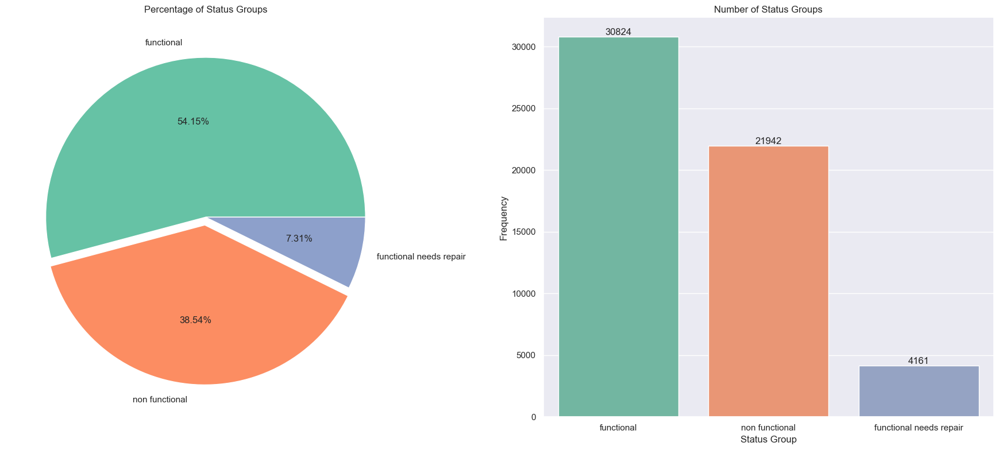

In [262]:
#  define a custom color palette
colors  = ['#66c2a5', '#fc8d62', '#8da0cb']
palette = sns.color_palette(colors)

#  Prepare figure
f, ax = plt.subplots(1, 2, figsize=(18, 8))

# Pie chart of status_group percentages
status_counts = df['status_group'].value_counts()
status_counts.plot(
    kind='pie',
    autopct='%.2f%%',
    ax=ax[0],
    explode=[0, 0.05, 0],          
    labels=status_counts.index,     
    colors=colors
)
ax[0].set_ylabel('')               
ax[0].set_title('Percentage of Status Groups')

#  Countplot of status_group frequencies
sns.countplot(
    x='status_group',
    data=df,
    ax=ax[1],
    palette=palette
)
ax[1].set_title('Number of Status Groups')
ax[1].set_xlabel('Status Group')
ax[1].set_ylabel('Frequency')

# annotate bars with counts
for container in ax[1].containers:
    ax[1].bar_label(container)

plt.tight_layout()
plt.show()

We can see that the classes are imbalanced, especially the "functional but needs repair" category, which is significantly underrepresented. This imbalance could cause issues during machine learning model training, so it's important to take it into account and consider applying class balancing techniques.

# 16. Correlation between variables

In [263]:
# compute Spearman corr and mask the upper triangle
corr = X.corr(method='spearman')
mask = np.triu(np.ones_like(corr, dtype=bool))
corr_masked = corr.mask(mask)

# build the heatmap
fig = go.Figure(
    data=go.Heatmap(
        z=corr_masked.values,
        x=corr_masked.columns,
        y=corr_masked.index,
        zmin=-1, zmax=1,
        colorscale='RdBu',         
        colorbar=dict(title='Spearman\nCorrelation'),
        text=corr_masked.round(2).astype(str),    
        texttemplate="%{text}",
        hoverongaps=False
    )
)

# style the figure
fig.update_layout(
    title='Spearman Correlation of Features',
    width=900,
    height=800,
    xaxis=dict(tickangle=45),
    yaxis=dict(autorange='reversed')  
)

fig.show()


# 17. Split Training and Testing

In [264]:
# Split X and y into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0) 

# 18. Scaling

In [265]:
# Feature Scaling
scaler = MinMaxScaler() 
scaler.fit(X_train) 
X_train = scaler.transform(X_train)

scaler = MinMaxScaler() 
scaler.fit(X_test) 
X_test = scaler.transform(X_test)

# 19. Modeling

## LightGBM

"Since the classes of the well state are imbalanced, we took this into account during model training by using the class_weight='balanced' parameter to compensate for the imbalance and improve prediction accuracy for the less represented classes."

In [270]:
from sklearn.metrics import balanced_accuracy_score

# LightGBM with early stopping & CV 

dtrain = lgb.Dataset(X_train, label=y_train)
dtest  = lgb.Dataset(X_test,  label=y_test, reference=dtrain)

params = {
    'objective': 'multiclass',
    'num_class': 3,
    'metric': 'multi_logloss',
    'learning_rate': 0.05,
    'num_leaves': 31,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'class_weight': 'balanced',
    'seed': 42,
}

# train with early stopping
gbm = lgb.train(
    params, 
    dtrain,
    num_boost_round=1000,
    valid_sets=[dtrain, dtest],
    valid_names=['train','test'],
    callbacks=[
        lgb.early_stopping(stopping_rounds=50),
        lgb.log_evaluation(period=50)
    ]
)

[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1879
[LightGBM] [Info] Number of data points in the train set: 39848, number of used features: 67
[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Info] Start training from score -0.608544
[LightGBM] [Info] Start training from score -2.614517
[LightGBM] [Info] Start training from score -0.960624
Training until validation scores don't improve for 50 rounds
[50]	train's multi_logloss: 0.579027	test's multi_logloss: 0.598642
[100]	train's multi_logloss: 0.524595	test's multi_logloss: 0.558317
[150]	train's multi_logloss: 0.495513	test's multi_logloss: 0.542722
[200]	train's multi_logloss: 0.474132	test's multi_logloss: 0.533546
[250]	train's multi_logloss: 0.455923	test's multi_log

In [271]:
from sklearn.metrics import balanced_accuracy_score

#  Evaluate on TRAIN & TEST 
def eval_set(model, X, y, name="set"):
    y_pred = np.argmax(model.predict(X), axis=1)
    print(f"\n==={name.upper()}===")
    print("Acc:", accuracy_score(y, y_pred))
    balanced_acc = balanced_accuracy_score(y, y_pred)
    print("Balanced Acc:", balanced_acc)
    print("F1w:", f1_score(y, y_pred, average='weighted'))
    print(confusion_matrix(y, y_pred, normalize='true'))
    print(classification_report(y, y_pred))

eval_set(gbm, X_train, y_train, "train")
eval_set(gbm, X_test,  y_test,  "test")


===TRAIN===
Acc: 0.8875225858261393
Balanced Acc: 0.7976196417389999
F1w: 0.8846801421386429
[[0.95909238 0.00682562 0.034082  ]
 [0.34144669 0.59136099 0.06719232]
 [0.15228227 0.00531217 0.84240556]]
              precision    recall  f1-score   support

           0       0.86      0.96      0.91     21683
           1       0.88      0.59      0.71      2917
           2       0.93      0.84      0.89     15248

    accuracy                           0.89     39848
   macro avg       0.89      0.80      0.83     39848
weighted avg       0.89      0.89      0.88     39848


===TEST===
Acc: 0.8040283388957199
Balanced Acc: 0.6479591207695377
F1w: 0.793778227290302
[[0.9135762  0.01498742 0.07143639]
 [0.58360129 0.27813505 0.13826367]
 [0.23692859 0.01090529 0.75216612]]
              precision    recall  f1-score   support

           0       0.78      0.91      0.84      9141
           1       0.62      0.28      0.38      1244
           2       0.86      0.75      0.80      669

Classes 0 and 2 show satisfactory results, while Class 1 exhibits low recall and F1-scores, particularly in the test set, indicating difficulties in correctly identifying this category. The confusion matrices confirm that errors are concentrated in Class 1, which is frequently misclassified as either Class 0 or 2. Despite balancing techniques applied to the dataset, Class 1 continues to perform poorly, likely due to its inherent underrepresentation. Even with oversampling or weighting methods, the model struggles to generalize for this class, as its features may overlap with those of Classes 0 and 2, making it difficult to distinguish. Additionally, the nature of the data itself may introduce noise or ambiguity in Class 1 samples.

# 20. Submision

## ML Pipeline

I condensed all the work I did so that it would be shorter and more practical for production, and this is the code I used to create the CSV to upload on the drivendata website."

In [210]:
# Preprocessing 
def preprocess(df, is_train=True):
    # drop truly redundant columns if present
    drop_cols = [
      'num_private','payment_type','quantity_group','waterpoint_type_group',
      'extraction_type','extraction_type_group','source','source_class',
      'water_quality','recorded_by','region_code','district_code',
      'amount_tsh','lga','ward','subvillage','scheme_name','wpt_name'
    ]
    df = df.drop(columns=[c for c in drop_cols if c in df], errors='ignore')

   
    for c in ['funder','installer','scheme_management','permit','public_meeting']:
        df[c].fillna(df[c].mode()[0], inplace=True)

    # fix zeros in longitude
    lon_mode = df.loc[df.longitude!=0, 'longitude'].mode()[0]
    df['longitude'].replace(0, lon_mode, inplace=True)

    # population: zeros → positive mean
    pop_mean = df.loc[df.population>0, 'population'].mean()
    df['population'].replace(0, pop_mean, inplace=True)

    # construction_year: zeros → nonzero mode
    cy_mode = df.loc[df.construction_year>0, 'construction_year'].mode()[0]
    df['construction_year'].replace(0, cy_mode, inplace=True)

    # gps_height: <=0 → region median or overall
    rg_med    = df.loc[df.gps_height>0].groupby('region').gps_height.median()
    overall_med = df.loc[df.gps_height>0,'gps_height'].median()
    mask_bad  = df.gps_height <= 0
    df.loc[mask_bad, 'gps_height'] = df.loc[mask_bad,'region'].map(rg_med).fillna(overall_med)

    # parse date
    df['date_recorded'] = pd.to_datetime(df['date_recorded'])
    df['year_recorded']  = df.date_recorded.dt.year
    df['month_recorded'] = df.date_recorded.dt.month
    df['day_recorded']   = df.date_recorded.dt.day
    df.drop(columns='date_recorded', inplace=True)

    # new features
    df['well_age']   = df['year_recorded'] - df['construction_year']
    df['month_sin']  = np.sin(2*np.pi * df.month_recorded / 12)
    df['month_cos']  = np.cos(2*np.pi * df.month_recorded / 12)

    # geo clustering (use a fixed model for train/test!)
    if is_train:
        km = KMeans(n_clusters=50, random_state=42)
        df['zone'] = km.fit_predict(df[['latitude','longitude']])
        joblib.dump(km, 'km.geo.joblib')
    else:
        km = joblib.load('km.geo.joblib')
        df['zone'] = km.predict(df[['latitude','longitude']])

    # relative metrics
    for col in ['population','gps_height']:
        df[f'{col}_rel'] = df[col] / df.groupby('region')[col].transform('median')

    # booleans → ints
    df['public_meeting'] = df['public_meeting'].astype(int)
    df['permit']         = df['permit'].astype(int)

    return df

# Fuzzy‐reduce helper 
def fuzzy_reduce(df, col, threshold=75, min_pct=2.0):
    s = df[col].str.lower().str.strip().fillna('other')
    names = s.unique().tolist()
    freqs = s.value_counts()
    mapping = {}
    for name in tqdm(names, desc=f"Reducing {col}"):
        if name in mapping: continue
        matches = process.extract(name, names, scorer=fuzz.token_sort_ratio)
        group   = [m for m, score in matches if score>=threshold]
        canon   = freqs.loc[group].idxmax()
        for m in group:
            mapping[m] = canon
    df[col] = s.map(mapping)
    major = freqs[freqs >= len(df)*min_pct/100].index
    df[col] = df[col].where(df[col].isin(major), other='other')
    return df

# Load & preprocess TRAIN -
train_vals = pd.read_csv(r"C:\Users\andre\Desktop\Tarea Machine Learning\training_set_values.csv")
train_labs = pd.read_csv(r"C:\Users\andre\Desktop\Tarea Machine Learning\training_set_labels.csv")
df_train   = pd.merge(train_vals, train_labs, on='id')

df_train = preprocess(df_train, is_train=True)
df_train = fuzzy_reduce(df_train, 'funder',    threshold=75, min_pct=2.0)
df_train = fuzzy_reduce(df_train, 'installer', threshold=75, min_pct=2.0)

#  Prepare X, y with hybrid encoding 
# label‐encode target
le_status = LabelEncoder().fit(df_train['status_group'])
y = le_status.transform(df_train['status_group'])
joblib.dump(le_status, "le.status.joblib")

# separate features
X = df_train.drop(columns=['id','status_group'])

# pick categorical columns
cat_cols = X.select_dtypes(include='object').columns.tolist()

# split high vs low cardinality
nuniques = X[cat_cols].nunique()
high_card = nuniques[nuniques>10].index.tolist()
low_card  = nuniques[nuniques<=10].index.tolist()

# target‐encode high‐card cats
te = TargetEncoder(cols=high_card, smoothing=0.3)
X = te.fit_transform(X, y)
joblib.dump(te, "te.highcard.joblib")

# one-hot encode remaining lows
X = pd.get_dummies(X, columns=low_card, drop_first=False)

# save train columns
train_cols = X.columns
joblib.dump(train_cols, "train.columns.joblib")

# Split & scale 
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=42, stratify=y
)

scaler = MinMaxScaler().fit(X_train)
X_train_sc = scaler.transform(X_train)
X_test_sc  = scaler.transform(X_test)
joblib.dump(scaler, "scaler.joblib")

# LightGBM with early stopping & CV 

dtrain = lgb.Dataset(X_train_sc, label=y_train)
dtest  = lgb.Dataset(X_test_sc,  label=y_test, reference=dtrain)

params = {
    'objective': 'multiclass',
    'num_class': 3,
    'metric': 'multi_logloss',
    'learning_rate': 0.05,
    'num_leaves': 31,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'class_weight': 'balanced',
    'seed': 42,
}

# train with early stopping
gbm = lgb.train(
    params, 
    dtrain,
    num_boost_round=1000,
    valid_sets=[dtrain, dtest],
    valid_names=['train','test'],
    callbacks=[
        lgb.early_stopping(stopping_rounds=50),
        lgb.log_evaluation(period=50)
    ]
)

joblib.dump(gbm, "lgb_model.joblib")

#  Evaluate on TRAIN & TEST 
def eval_set(model, X, y, name="set"):
    y_pred = np.argmax(model.predict(X), axis=1)
    print(f"\n==={name.upper()}===")
    print("Acc:", accuracy_score(y, y_pred))
    print("Balanced Acc:", balanced_accuracy_score(y, y_pred))
    print("F1w:", f1_score(y, y_pred, average='weighted'))
    print(confusion_matrix(y, y_pred, normalize='true'))
    print(classification_report(y, y_pred))

eval_set(gbm, X_train_sc, y_train, "train")
eval_set(gbm, X_test_sc,  y_test,  "test")

# Prepare TEST for submission 
df_test = pd.read_csv(r"C:\Users\andre\Desktop\Tarea Machine Learning\test_set_values.csv")
test_ids = df_test['id'].copy()

df_test = preprocess(df_test, is_train=False)
df_test = fuzzy_reduce(df_test, 'funder',    threshold=75, min_pct=2.0)
df_test = fuzzy_reduce(df_test, 'installer', threshold=75, min_pct=2.0)

X_sub = df_test.drop(columns=['id'])
X_sub = joblib.load("te.highcard.joblib").transform(X_sub)
X_sub = pd.get_dummies(X_sub, drop_first=False)
X_sub = X_sub.reindex(columns=joblib.load("train.columns.joblib"), fill_value=0)
X_sub_sc = joblib.load("scaler.joblib").transform(X_sub)

# Predict & build submission 
model = joblib.load("lgb_model.joblib")
y_sub = np.argmax(model.predict(X_sub_sc), axis=1)
labels = joblib.load("le.status.joblib").inverse_transform(y_sub)

submission = pd.DataFrame({'id': test_ids, 'status_group': labels})
submission.to_csv("submission.csv", index=False)
print("Wrote", len(submission), "rows to submission.csv")


Reducing installer: 100%|██████████| 1935/1935 [00:51<00:00, 37.49it/s]


[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011777 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1932
[LightGBM] [Info] Number of data points in the train set: 41580, number of used features: 84
[LightGBM] [Warning] Unknown parameter: class_weight
[LightGBM] [Info] Start training from score -0.610510
[LightGBM] [Info] Start training from score -2.621700
[LightGBM] [Info] Start training from score -0.956469
Training until validation scores don't improve for 50 rounds
[50]	train's multi_logloss: 0.570728	test's multi_logloss: 0.583046
[100]	train's multi_logloss: 0.521803	test's multi_logloss: 0.547663
[150]	train's multi_logloss: 0.494901	test's multi_logloss: 0.53264
[200]	train's multi_logloss: 0.474935	test's multi_logloss: 0.523451
[250]	train's multi_logloss: 0.457783	test's multi_logl

Reducing installer: 100%|██████████| 979/979 [00:16<00:00, 60.08it/s]


Wrote 14850 rows to submission.csv


# 21. Conclusions

During the various stages of experimentation with machine learning models, I tested several approaches to data preprocessing. Specifically, I tried different methods for handling missing values (NaNs), reintroduced variables that I had previously excluded, and experimented with different techniques for outlier treatment. 

Once I finalized the preprocessing approach, the main differences between models concerned the tuning of hyperparameters, the threshold value, and the min_pic parameter.

To select the best-performing model, I focused on the difference between the training and test set results. I ultimately chose the model with the smallest gap between training and test metrics. Other models exhibited higher performance on the training set (up to 0.95) but test set metrics ranging between 0.78 and 0.80, which led me to suspect overfitting. For this reason, I prioritized a model with more balanced performance across both datasets.

<img src="https://worldbank.scene7.com/is/image/worldbankprod/tz-water-child-780?wid=780&hei=439&qlt=85,0&resMode=sharp" width="600" />

---

# Other ML models tested but not chosen 

## Random Forest with OOB and CV 

### Hyperparameter tuning

In [211]:
# I tried various parameter values (in addition to those in the code)


## LGBMClassifier, early_stopping, log_evaluation

**END**
---